# ML Auto 15.ipynb

Válaszható lett.

> Itt annyit változtattam, hogy 'Action' után is visszaengedem a before after adatokat. Ennyivel bővülnek a before after adatok. Igy nem csak a mesterséges mozgatás által jut adatokhoz.

Bevezetésre került:

> Kivettem a before after linreg becslésből az Interceptet

Bevezetésre került:

> Linreg helyett MLP van a main modelben

Bevezetésre került:

> Az action kiszámolásánál az új érték is -1, 1 közé lesz normalizálva


# ToDo
letölteni a pythont és ott futtatni a kódot

huzzon egy nyomot a becslésre is, hogy lássam, hogy hova a faszomba becsüli az első modell
a mit is? ja igen a középtől való eltérést.

csinálni egy második modelt illetve kettőt

az egyik legyen a régi, de hagyjuk a faszba a fel-le becslést, az egész before aftert
és csak egyszerűen kössünk rá a becslésre valamilyen szabályt. Ha nagyobb mint x akkor +3

a másik verzió amit gyorsan ki kéne próbálni, hogy a linreg helyett beteszek egy mlp-t

**ToDo:**

Megnézni, hogy normalizálom-e az adatokat a neruális háló előtt, mert lehet hogy ez viszi félre a becslést.

**Gondolat:**

Nyilvánvaló, hogy egy idő után se a before after adatokra nem képes jó becslést adni
```
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[2.13709439]]
-------- 1 y up ->  center =  [[1.94404015]]
-------- 1 y up ->  right  =  [[1.85292015]]
```
Ezért arra gondoltam, hogy beeresztem azokat az adatokat is, amelyeket az action körben lép meg.
Ha úgy se megy akkor át kell gondolni a képletet! A becslés képleétt, before after.

A másik, hogy csinálni kéne egy ábrát arra nézve, hogy mi a kapcsolat a tényleges before after között és nem csinálni rá semmilyen becslét.
Egyszerűen minden metrikára megnézni, hogy mi a lépés elötti adata és mi a lépés utáni adata. Ezt meg lehet csinálni úgy, hogy egy ploton vízszintesen van before, fűggőlegesen az after, és színnel van kódolva az action (kék +1, piros -1)

Amúgy most jutott eszembe, hogy egyébként a 0 actionre nem is becsülünk lehet, hogy ez is hiba.

Vagy úgy is lehet ábrázolni, hogy egy ploton van a +1 és külön egy másik ploton a -1. A lényeg, hogy nem becslés, hanem a before after közötti kapcsolat szenzoronként.

A fenti viszgálatot azért végzem el, hogy lássam, hol kap olyan adatokat ** milyen helyzetben kap olyan adatokat ** a before after adatsor amitől ilyen mértékben elromlik az előre jelző képessége.

2. Teljesen nyilvánvaló, hogy a szenzoros adatok és a tengelytől mért távolság közötti kapcsolatot a lineáris regresszió képtelen megragadni.

3. Utána ki kell próbálni, hogy a szenzorok nem előre néznek, hanem oldalra. Igen ez teljes egészében az amit a célváltozó is mér. De csak ellenőrzés végett.



# Micado Auto Scale Research

Ebben a felskálázási adatok elemzésével foglalkozom.

Ez az interkatív bemutató arra van, hogy a válotzók közötti összefüggéseket jobban átlásssam, elemezzem, az esetleges anomáliákat rögtön kiszúrjam.

A playground részben a rendszer alapját adó neuráli háló beállításaival lehet játszani és megfigyelni, hogy milyen hatással van a rendszer teljesítményére.

<a name="tartalom"></a>

## Tartalom

Bevezetés

> [Empty](#empty)<br>
> [Play Ground](#play_ground)<br>
> [SandBox](#sandbox)<br>
> [Before After](#beforeafter)<br>
> [Szintetikus adatok generálása](#szintetikus_adatok)<br>
> [Irodalom](#irodalom)<br>
> [ToDo](#todo)<br>


## Bevezető gondolat

Összességében az egésszel kapcsolatban van egy hatalmas kérdőjel.

Tulajdonképpen két paradigma van.

Az egyik - nem az enyém - így néz ki:

Egyszerűen becsüjük meg azt, hogy az adott szenzoros adatok alapján mi legyen a döntés kimenetele (fel, le, semmi). Akkor hoztunk jó döntést, ha valamilyen metrika alapján valamilyen költséget minimalizáltunk, vagy maximalizáltunk. Például, ha egy döntéssel sikerült közelebb kerülni a záróvonalhoz, vagyis az út közepére. Vagy az az autó a lehető legmeszebb jutott el anélkül, hogy érintette volna a falat és lehetőleg a leggyorsabban is.

A másik - amin én dolgozom - viszont egy plusz lépéssel egészül ki és ettől sokkal bonyolultabb. Hogy van-e létjogosultsága az ennek a kisérletnek a lényege.

Vannak szenzoros adataink, ami alapján hozunk egy döntést. Eddig olyan mint a máisik, de az érdemi különbség a módszerben és a tanulás folyamatában van.

A szenzoros adatokból megbecsüljük azt, hogy mennyire vagyunk jók és nem azt becsüljük, hogy mit kéne tenni!

Ha nem vagyunk jók akkor egy második modell segítségével csinálunk valamilyen lépést, amitől azt várjuk, hogy jók leszünk.

És itt jogosan merül fel a kérdés, hogy de miért nem az első módszert alkalmazzuk és erre most még én sem tudom a választ pontosan megadni. De röviden erről szól ez a kutatás.

## Paradmigva váltás

Miért olyan nehéz debuggolni ezt a rendszert?

Azért mert ha belegondolsz felügyelt tanulásnál mutatsz egy mintát, a rendszer kiszámolja a hibát és a hiba szerint módosítja a tanulásnál a súlyokat.

Itt viszont mutatsz egy mintát a rendszer kiszámoja a hibát a hiba szerint módosítja a súlyokat, a súlyok alapján hoz egy döntést, AMIT VISSZACSATOLÓDIK A RENDSZERBE olyan formán, hogy ezzel a lépéésel megváltoznak a bemeneti adatok, ami alapján újra tanítjuk a rendszert, és így tovább ahogy haladunk előre az időben, a tanulás során.

>> Attól lesz reinforcement learning, hogy a döntést visszatápláljuk a rendszerbe, ezáltal megváltoznak a bemeneti adatok. Ez a legnagyobb különbség a super-vised és a re-enforcement learning között.

In [1]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn.linear_model import LinearRegression
from sklearn.neural_network import MLPRegressor
from sklearn.preprocessing import MinMaxScaler

import warnings
warnings.filterwarnings('ignore')

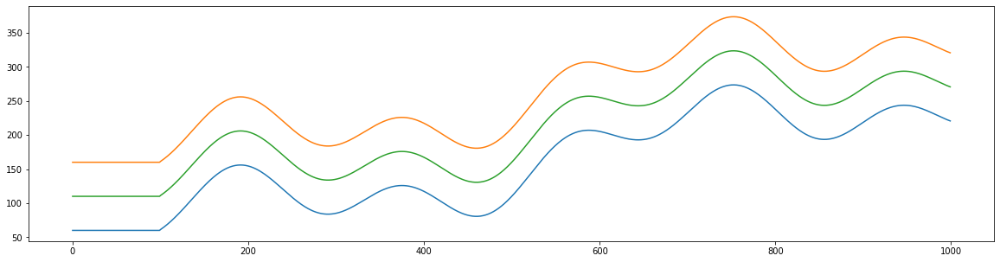

In [2]:
distance    = np.arange(0, 1000, 1)
road        = 100
wall_left   = 30*(np.sin(distance/180)) + distance * 0.3 + 30 * np.cos(distance/30) + 50 * np.sin(distance/90)
wall_left[0:100] = 60
wall_right  = wall_left + road
wall_center = ( wall_left + wall_right ) / 2


plt.figure(figsize=(20,5)); plt.plot(wall_left); plt.plot(wall_right); plt.plot(wall_center); plt.show()

In [3]:
class Road():
  def __init__(self, wide):
    self.distance    = np.arange(0, 3000, 1)
    self.wide        = wide
    self.wall_right  = 30*(np.sin(self.distance/180)) + self.distance * 0.3 + 30 * np.cos(self.distance/30) + 50 * np.sin(self.distance/90)
    self.wall_right[0:100] = 60
    self.wall_left   = self.wall_right + self.wide
    self.wall_center = ( self.wall_left + self.wall_right ) / 2

  def show(self):
    fig, ax = plt.subplots(figsize=(26,10)); ax.set_ylim(40, 1000); ax.plot(self.wall_left); ax.plot(self.wall_right); ax.plot(self.wall_center);
    return fig, ax


In [4]:
class Car():
  def __init__(self, road):
    self.road = road
    self.x = 0
    self.y = self.road.wall_center[0]
    self.sight = 400           # ennyit lát előre 300, 54, 154
    self.sight_center = 400    # ennyit lát előre 150

    self.y_history  = []
    self.x_history  = []
    self.y_center   = []; self.y_center = self.road.wall_center
    self.y_distance = []
    self.y_distance_real = []
    self.y_distance_predicted = []
    self.regression = LinearRegression(fit_intercept=False)
# Bevezetésre került az MLPRegreression
    self.mlp = MLPRegressor(hidden_layer_sizes=(10, 5),
                            activation='relu',
                            solver='adam',
                            batch_size='auto',
                            learning_rate_init=0.01,
                            max_iter=1000,
                            shuffle=True,
                            random_state=1,
                            momentum=0.9,
                            nesterovs_momentum=True,
                            early_stopping=True,
                            n_iter_no_change=1000)
# Bevezetésre került az X MinMaxScaler
    self.x_minmaxscaler = MinMaxScaler(feature_range=(-1,1))
# Bevezetésre került az y MinMaxScaler
    self.y_minmaxscaler = MinMaxScaler(feature_range=(-1,1))
#
#    self.regression_left = LinearRegression()
    self.regression_left = LinearRegression(fit_intercept=False)
#    self.regression_center = LinearRegression()
    self.regression_center = LinearRegression(fit_intercept=False)
#    self.regression_right = LinearRegression()
    self.regression_right = LinearRegression(fit_intercept=False)

# most
    self.sensor_center = []
    self.sensor_left   = []
    self.sensor_right  = []
    self.before  = []
    self.after   = []

    self.mesterseges_coutner = 0


  def calculate_distances(self):
    # ha bármikor kevesebb a faltól mért távolsága bármelyik szenzoron akkor a szenzorokon mért távolság is ennyi lesz
    
    k = self.x; d = 0
    while(k < self.x + self.sight_center):
      k += 1; d += 1
      self.distance_center_from_wall = d
      if(int(self.road.wall_left[k]) < self.y):
        print('Sensor center = ', self.distance_center_from_wall)
        break
      if(int(self.road.wall_right[k]) > self.y):
        print('Sensor center = ', self.distance_center_from_wall)
        break

    k = self.x; d = 0
    while(k < self.x + self.sight):
      k += 1;  d += 1
      self.distance_left_from_wall = d
      if(int(self.road.wall_left[k]) < self.y + d):
        print('Sensor from left wall = ', self.distance_left_from_wall)
        break

    k = self.x; d = 0
    while(k < self.x + self.sight):
      k += 1; d += 1
      self.distance_right_from_wall = d
      if(int(self.road.wall_right[k]) > self.y - d):
        print('Sensor from right wall = ', self.distance_right_from_wall)
        break

    #ki kell kalkulálni a tényleges távolságot a ball és a jobb faltól
    # mert ezekre fogom tanítani a neurális hálót, ahol ezeket becsüljük
    # és a bemeneti változó a 3 szenzorból érkező adat lesz.
    # valójában azt mérjük, hogy milyen távolságra van az út közepétől

    self.distance_from_top     = abs(self.road.wall_left[self.x] - self.y)
    self.distance_from_bottom  = abs(self.road.wall_right[self.x] - self.y)
    print('most távolsagra van a felső faltól = ', self.distance_from_top)
    print('most távolsagra van az alsó faltól = ', self.distance_from_bottom)


    print('cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc')
    print('self.x                       = ', self.x)
    print('cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc')

    # mi lenne, ha mégis inkább a kettő hányadosát becsülném (1 ha egyenlő távolságra van)
    # self.vertical_distance_from_middle = self.road.wall_center[self.x] - self.y
    # self.vertical_distance_from_middle = self.distance_from_top / self.distance_from_bottom

    self.vertical_distance_from_middle = self.y - self.road.wall_center[self.x]

    print('KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK')
    print('self.vertical_distance_from_middle = ', self.vertical_distance_from_middle)
    print('KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK')




    print('ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa = ', self.vertical_distance_from_middle)


    # de elötte szeretnék még valamit leellenőrizni
    # ezeknek a hossza nem fog megeggyezni a tényleges futások számával, hanem több lesz (milyen jó lett volna erre egy teszt esetet írni és akkor test driven development lenne)

    print('\t\t\t ---------------- Teszt ----------------')
    print('\t\t\t len(self.y_distance)    = ', len(self.y_distance))
    print('\t\t\t len(self.sensor_left)   = ', len(self.sensor_left))
    print('\t\t\t len(self.sensor_center) = ', len(self.sensor_center))
    print('\t\t\t len(self.sensor_right)  = ', len(self.sensor_right))
    print('\t\t\t self.x                  = ', self.x)
    print('\t\t\t -------------- Teszt End --------------')


  def append(self):
    self.y_distance.append(self.vertical_distance_from_middle)

    self.sensor_left.append(self.distance_left_from_wall)
    self.sensor_center.append(self.distance_center_from_wall)
    self.sensor_right.append(self.distance_right_from_wall)

    print('\t\t\t ---------------- Append ----------------')
    print('\t\t\t len(self.y_distance)    = ', len(self.y_distance))
    print('\t\t\t len(self.sensor_left)   = ', len(self.sensor_left))
    print('\t\t\t len(self.sensor_center) = ', len(self.sensor_center))
    print('\t\t\t len(self.sensor_right)  = ', len(self.sensor_right))
    print('\t\t\t self.x                  = ', self.x)
    print('\t\t\t -------------- Append End --------------')


  def run(self):
    for i in range(0, 3000, 1):
      print('# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------')
      _summary_mlp_prediction_was_taken = 0
      _summary_mlp_fit_was_taken = 0
      _summary_mesterseges_mozgatas = 0
      _summary_action_was_taken = 0

      self.x = i
      self.calculate_distances()
      # !!!
      self.append()
      # !!!
      if( i % 1 == 0 ):
        if ( i % 80 == 0 ):
          self.plot()
          print(' --- plot --- ')

      if( i >= 0 ):

        if( i % 3 == 0 and i >= 12 ):

          print('------------------------------ IF i % 3 == 0 ------------------------------')
          print('# i = ', i)
          print('# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)')
          X = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
          y = np.array([self.y_distance]).T
          print('X.shape = ', X.shape)
          print('y.shape = ', y.shape)
          # print('X       = ', X)
          # print('y       = ', y)
          print('i       = ', i)
          self.regression.fit(X, y)
          _summary_mlp_fit_was_taken = 1
# Lineáris regresszió helyett Neurális hálót használok
          self.x_minmaxscaler.fit(X)
          self.y_minmaxscaler.fit(y)
          X_scaled = self.x_minmaxscaler.transform(X)
          y_scaled = self.y_minmaxscaler.transform(y)
          print('---------------------')
          print('X.max = ', X.max())
          print('X.min = ', X.min())
          print('X[:,0].max = ', X[:,0].max())
          print('X[:,0].min = ', X[:,0].min())
          print('X[:,1].max = ', X[:,1].max())
          print('X[:,1].min = ', X[:,1].min())
          print('X[:,2].max = ', X[:,2].max())
          print('X[:,2].min = ', X[:,2].min())
          print('y.max = ', y.max())
          print('y.min = ', y.min())
          print('---------------------')
          print('X_scaled.shape = ', X_scaled.shape)
          print('y_scaled.shape = ', y_scaled.shape)
          print('X_scaled.max = ', X_scaled.max())
          print('X_scaled.min = ', X_scaled.min())
          print('X_scaled[:,0].max = ', X_scaled[:,0].max())
          print('X_scaled[:,0].min = ', X_scaled[:,0].min())
          print('X_scaled[:,1].max = ', X_scaled[:,1].max())
          print('X_scaled[:,1].min = ', X_scaled[:,1].min())
          print('X_scaled[:,2].max = ', X_scaled[:,2].max())
          print('X_scaled[:,2].min = ', X_scaled[:,2].min())
          print('y_scaled.max = ', y_scaled.max())
          print('y_scaled.min = ', y_scaled.min())
          print('---------------------')
          self.mlp.fit(X_scaled, y_scaled)


        if( i % 3 == 1 and i >= 22 ):

          print('------------------------------ IF i % 3 == 1 ------------------------------')
          print('# i = ', i)
          print('# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja')
          X_test = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
          _X_test = np.array([X_test[-1,:].reshape(-1,1)])
          _X_test = np.array([X_test[-1,:]])
          print('actual _X_test = ', _X_test)
          predicted_test = self.regression.predict(_X_test)
# Lineáris regresszió helyett Neurális hálót használok
          _X_test_scaled = self.x_minmaxscaler.transform(_X_test)
          predicted_test = self.mlp.predict(_X_test_scaled)
# ToDo : Fontos lenne visszatranszformálni a predicted_test értéket mielőtt belekerül az archivumba
          _summary_mlp_prediction_was_taken = 1
          self.y_distance_real.append(self.y_distance[-1])
          self.y_distance_predicted.append(predicted_test)
          print('actual predicted = ', predicted_test)
          # print('actual predicted = {:.5f}'.format(predicted_test[0,0]))
          print('actual self.y_distance[-1] = ', self.y_distance[-1])
#          print('actual self.y_distance     = ', self.y_distance)
          print('len(self.y_distance_real)      = ', len(self.y_distance_real))
          print('len(self.y_distance_predicted) = ', len(self.y_distance_predicted))

          if( i % 32 == 0 ):
            # olyan szar a becslés, hogy az hihetetlen
            plt.figure(figsize=(12, 5)); plt.scatter(self.y_distance_real, self.y_distance_predicted)
            plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real'); plt.show()
            
            # korábban csak azokat az adatokat plottoltam amik a tanulás után lettek visszamérve,
            # de nézzük meg a teljes adatsoron
            X_test_full = np.array([self.sensor_left, self.sensor_center, self.sensor_right]).T
            _X_test_full = X_test_full
            predicted_test_full = self.regression.predict(_X_test_full)
# Lineáris regresszió helyett Neurális hálót használok
            _X_test_full_scaled = self.x_minmaxscaler.transform(_X_test_full)
            predicted_test_full = self.mlp.predict(_X_test_full_scaled)
# ToDo : itt még lehet, hogy kéne transzformálni y-t is és az egészet visszatranszformálni eredeti értékére + ellenőrizni, hogy tulajdonképpen amikor skálázom az y-t akkor mi alapján skálázok
            predicted_test_full = self.y_minmaxscaler.inverse_transform(predicted_test_full.reshape(-1, 1))
            _y_test_full = np.array([self.y_distance]).T
            print(_y_test_full.shape)
            print(predicted_test_full.shape)
            plt.figure(figsize=(12, 5)); plt.scatter(_y_test_full, predicted_test_full, c='r');
            plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real'); plt.show()

            _array_target = np.array([_y_test_full.ravel(), predicted_test_full.ravel(), np.arange(0, _y_test_full.shape[0], 1)]).T

            plt.figure(figsize=(12, 5)); plt.scatter(_array_target[:,0], _array_target[:,1], c=_array_target[:,2]);
            plt.ylabel('y_distance_predicted'); plt.xlabel('y_distance_real'); plt.show()

            plt.figure(figsize=(12, 5)); ax = plt.axes(); ax.scatter(_array_target[:,0], _array_target[:,1], c=_array_target[:,2])
            ax.plot([-10, 2, 4, 10], [-10, 2, 4, 10]); ax.set_ylabel('y_distance_predicted'); ax.set_xlabel('y_distance_real'); plt.show()
            print(' --- plot predcition --- ')


        # most jön az, hogy véletlenszerűen kell egyet ugrania fel, vagy le
        # ez felel meg a before after dologonak
        # az így létrejött adatokat is el kell tárolni úgy mint
        # mi volt a szezoros adat before
        # mi lett a szenzoros adat after
        # mi volt az y before, mi lett az y after
        # mivel mindíg egyet fogunk csak lépni, ezért a dif mindíg egy lesz
        # de ezt számítani kell, mivel a későbbiek folyamán lehet, hogy többet is fog lépni

        if( i % 3 == 2 ):

          print('------------------------------ IF i % 3 == 2 ------------------------------')
          print('# i = ', i)
          print('# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok')

          _summary_mesterseges_mozgatas = 1
          
          if( self.mesterseges_coutner == 0 ):                             # Első lépésben fel
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y + 1
            print('artificial move -> up first')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 1

          elif( self.mesterseges_coutner == 1 ):                           # Második lépésben le
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y - 1
            print('artificial move -> down first')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 2

          elif( self.mesterseges_coutner == 2 ):                           # Harmadik lépésben le
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y - 1
            print('artificial move -> down second')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 3

          elif( self.mesterseges_coutner == 3 ):                           # Negyedik lépésben fel
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.y = self.y + 1
            print('artificial move -> up second')
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            self.mesterseges_coutner = 0

          else:
            print('semmi\n\n\n\n')

          print('self.y = ', self.y)



# itt van egy érdekesség amit csak magamnak írok fel
# ezen a ponton lépünk ki a három if ágból - if( i % 3 == _ )

# ez azért fontos, mert ami itt következik az mindíg lefut
# akár volt neurális háló tanítás
# akár volt neurális háló predikció visszamérése
# akár volt mesterséges mozgatás


# felmerül a kérdés de csak felmerül, hogy nem lehet-e az, hogy ezt csak akkor kéne elvégezni amikor nincs neurális háló tanítás és nincs mesterséges mozgatás sem
# ezt csak egy kísérlet ereéig ki kéne próbálni (if i % 3 == 1) -> vagyis amikor az nn predikció mérése történik

        action = 0
        if( i % 3 == 0 ):

          if( len(self.before) > 9 ):           # ha már van néhány before after adatunk, akkor

            print('------------------------------ IF len(self.before) > 9 ------------------------------')
            print('\n')
            print('# i = ', i)
            print('  Ha már van elég before after adatunk')
            print('# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára')
            # minden egyes szezor adatára el kell készítenünk azt a lineráis regressziós modelt ami megmondja, hogy mi lenne a szenzor értéke, ha 1, 2, 3, ... n lépéssel elvinnénk a kocsit

            # oké megvan a before és megvan az after (self.y, left, center, right)
            before_array = np.array(self.before)
            after_array  = np.array(self.after)
            y_delta = after_array[:,0] - before_array[:,0]
            delta_array = after_array - before_array
#            print('--------------------------------------')
#            print(y_delta)
#            print(before_array.shape)
#            print(after_array.shape)
#            print('self.before = \n', self.before)
#            print('self.after  = \n', self.after)
#            print('delta_array = \n', delta_array)
#            print('--------------------------------------')

            # képlet szerint senzor' = w0 + w1 * senzor + w2 * delta_y
            # valójában ez a képlet nem jó és nem így kéne számolni, mert ez figyelembe veszi a szenzor aktuális értékét is, de most így hagyom
            # ------- fenti sort nem tudom miért írtam, hogy baj az ha figyelembe veszük az aktuális értéket is, hm.

            print('# Linear Regression Learning --------------------------------------------------------------------------------------')
            print('\t\t # Linear Regression Training Results -------------------------------------------------------------------------')

            _X_left = np.array([before_array[:,1], delta_array[:,0]]).T # left és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_left = delta_array[:,1].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_left = after = after_array[:,1].reshape(-1, 1)
#            regression_left = LinearRegression()
            regression_left = self.regression_left
            regression_left.fit(_X_left, _y_left)
            # print('\t\t _X_left = \n', _X_left)
            # print('\t\t _y_left = \n', _y_left)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_left.coef_ = ', regression_left.coef_)
            print('\t\t regression_left.intercept_ = ', regression_left.intercept_)
            _predicted_left = regression_left.predict(_X_left)
#            plt.scatter(_y_left, _predicted_left)
#            plt.ylabel('_predicted_left')
#            plt.xlabel('_true_y_left')
#            plt.show()
            # kiplottolom a before after adatokat egy konkrét szenzor értékeire
#            plt.scatter(before_array[:,1], after_array[:,1], c='black')
#            plt.ylabel('after')
#            plt.xlabel('before')
#            plt.show()

            _X_center = np.array([before_array[:,2], delta_array[:,0]]).T # center és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_center = delta_array[:,2].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_center = after_array[:,2].reshape(-1, 1)
#            regression_center = LinearRegression()
            regression_center = self.regression_center
            regression_center.fit(_X_center, _y_center)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_center.coef_ = ', regression_center.coef_)
            print('\t\t regression_center.intercept_', regression_center.intercept_)
            _predicted_center = regression_center.predict(_X_center)
#            plt.scatter(_y_center, _predicted_center)
#            plt.ylabel('_predicted_center')
#            plt.xlabel('_true_y_center')
#            plt.show()
            # kiplottolom a before after adatokat egy konkrét szenzor értékeire
#            plt.scatter(before_array[:,2], after_array[:,2], c='black')
#            plt.ylabel('after')
#            plt.xlabel('before')
#            plt.show()

            _X_right = np.array([before_array[:,3], delta_array[:,0]]).T # right és delta_y
  # ez itt teljesen hibás volt. nem a deltat kellet volna becsülnöm
            _y_right = delta_array[:,3].reshape(-1, 1)
  # itt ki lett javítva. nem a deltat kellett volna becsülnöm hanem az aftert     - a fenti sort azért hagytam benne, hogy lássam a hibát
            _y_right = after_array[:,3].reshape(-1, 1)
#            regression_right = LinearRegression()
            regression_right = self.regression_right
            regression_right.fit(_X_right, _y_right)
            print('\t\t ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------')
            print('\t\t regression_right.coef_ = ', regression_right.coef_)
            print('\t\t regression_right.intercept_ = ', regression_right.intercept_)
            _predicted_right = regression_right.predict(_X_right)
#            plt.scatter(_y_right, _predicted_right)
#            plt.ylabel('_predicted_right')
#            plt.xlabel('_true_y_right')
#            plt.show()
            # kiplottolom a before after adatokat egy konkrét szenzor értékeire
#            plt.scatter(before_array[:,3], after_array[:,3], c='black')
#            plt.ylabel('after')
#            plt.xlabel('before')
#            plt.show()


            # most ki kell számolni, hogy mennyi lenne a szenzorok értéke, ha fel le lépkednénk

            # mondjuk maximalizáljuk a fel le lépkedés mértékét 5-ben

            move = np.array([-5, -4, -3, -2, -1, 0, 1, 2, 3, 4, 5])

            move = np.array([-2, -1, 0, 1, 2])

            move = np.array([-3, -2, -1, 0, 1, 2, 3])

            move = np.array([-5, -4, -3, -2, -1, 0, 1, 2, 3, 4, 5])


  # most


            print('\t # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------')

            print('\t\t # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke')
            proba_X_metrika   = np.array([1,1]).reshape(1, -1)
            print('proba_X_metrika   = ', proba_X_metrika)
            predicted_proba_left = regression_left.predict(proba_X_metrika)
            predicted_proba_center = regression_center.predict(proba_X_metrika)
            predicted_proba_right = regression_right.predict(proba_X_metrika)
            print('-------- 1 y up ->  left   = ', predicted_proba_left)
            print('-------- 1 y up ->  center = ', predicted_proba_center)
            print('-------- 1 y up ->  right  = ', predicted_proba_right)
            print('\n')

            # EGY KURVA NAGY ELMÉLETI DILLEMMÁHOZ ÉRKEZTEM.

            # HÁROM MEGOLDÁS VAN

            # EBBŐL SZERINTEM MOST A LEGROSSZABBAT VÁLASZOTTAM

            # 1, MINDENKÉPPEN VÁLASZT EGYET, A LEGJOBBAT

            # 2, CSAK AKKOR MODOSÍT HA KÖZELEBB TUDJA VINNI A KÖZÉPPONTHOZ MINT AHOL MOST VAN
            
            action = 0; tmp = 999999990

            for j in move:
              print('\n')
              print('\t\t minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba')
              print('\t\t j = ', j)
              # ide be kell helyettesítenem az éppen aktuális értéket, olyan mintha egy új X változót csinálnék amiben csak egy sor van és arra kérnék egy becslést a korábbi modell alapján
              # a bement az éppen aktuális szenzoros érték és az új lépés

              # na majd ezt a bemenetet kell ellenőrizni, hogy stimmel-e a tanítás során használt bemenettel
              _X_left   = np.array([[self.distance_left_from_wall, j]])
              _X_center = np.array([[self.distance_center_from_wall, j]])
              _X_right  = np.array([[self.distance_right_from_wall, j]])

              print('\t\t ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------')
              print('\t\t _X_left   = ', _X_left)
              print('\t\t _X_center = ', _X_center)
              print('\t\t _X_right  = ', _X_right)

              # a fenti értékek valószínűleg jók, de mindíg minden lépésnél ellenőrizni kell

              predicted_left   = regression_left.predict(_X_left)
              predicted_center = regression_center.predict(_X_center)
              predicted_right  = regression_right.predict(_X_right)

              print('\t\t predicted_left   = ', predicted_left)
              print('\t\t predicted_center = ', predicted_center)
              print('\t\t predicted_right  = ', predicted_right)

              print('\t\t --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------')
              print('\t\t regression_left.coef_   = ', regression_left.coef_)
              print('\t\t regression_center.coef_ = ', regression_center.coef_)
              print('\t\t regression_right.coef_  = ', regression_right.coef_)
              print('\t\t regression_left.intercept_   = ', regression_left.intercept_)
              print('\t\t regression_center.intercept_ = ', regression_center.intercept_)
              print('\t\t regression_right.intercept_  = ', regression_right.intercept_)

              # nekünk majd azt az értéket kell választanunk amelyik segítségével a legközelebb jutunk a 1 értékhez

              _X = np.array([predicted_left.ravel(), predicted_center.ravel(), predicted_right.ravel()]).T    # figyelni kell rá, hogy eredetileg is ez volt-e a változók sorrendje

              print('\t\t # Ez lesz a bemenete a neurális hálónak')
              print('\t\t -------------------------X-------------------------')
              print('\t\t ', _X)
              print('\t\t ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------')

              predicted_position = self.regression.predict(_X)
              print('\t\t predicted_position linreg model            = ', predicted_position)
# Lineáris regresszió helyett Neurális hálót használok
# Lehet, hogy itt fit_transform használata lenne a helyes!!!!!!!!!!!!!!!!!!!!!!!!
              _X_scaled = self.x_minmaxscaler.transform(_X)
              predicted_position_scaled = self.mlp.predict(_X_scaled)
              print('\t\t predicted_position neural net model scaled = ', predicted_position_scaled)
# Vissza kell transzformálnom eredeti formájába
              predicted_position = self.y_minmaxscaler.inverse_transform(predicted_position_scaled.reshape(-1, 1))
              print('\t\t predicted_position neural net model inverz = ', predicted_position)
# Ez nem lesz könnyű
# Itt meg fogom csinálni, hogy úgy számolja ki az új értékekre a normalizációt, hogy az új érték is mindenféleképen -1, 1 közé essen
              print('\t\t\t xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx')
              print('\t\t\t    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva')
              print('\t\t\t _X_scaled = ', _X_scaled)
              print('\t\t\t    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva')
              print('\t\t\t predicted_position_scaled = ', predicted_position_scaled)
# Ami itt nehéz lesz, hogy a régi X értékekhez, vagy ahhoz amin elvégeztem az x_minmaxscalert hozzá kell csapnom az új linreg által számolt _X
# tömböt és azon megcsiálnom a teljes skálázást (bár ez az egész módszer nem biztos, hogy jó, sőt, de nincs jobb ötletem)

              print('\t\t --------------------------------------------------------------------------------------------------------------------------------------')

              # legyünk bátrak és módosítsuk az autó self.y pozicióját

              # azzal az értékkel amely abszolút értékben a legkissebb, helyett
              # mivel a célváltozónk akkor jó ha 1. mivel a felső/alsótól mért távolság hányadosa
              # ezért itt azt az értéket kell kiválasztani ami a legközelebb van +1-hez (és nem azt amelyik 0-hoz)

              # természetesen ezen változtatni kell ha ismét az középvonaltól való eltérés mértékét akarjuk becsülni
              # de ahhoz fenti is át kell állítani az adatokat

              if( abs(0 - predicted_position) < tmp):       # rossz - javítva - tesztelés alatt
                action = j
                tmp = abs(0 - predicted_position)
                print('\t\t ---------------------')
                print('\t\t  action = ', action)
                print('\t\t  predicted_position = ', predicted_position)
                print('\t\t  distance from 0 (tmp)= ', tmp)
                print('\t\t ---------------------')

              print('\t\t adott j-re {0} kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------'.format(j))
              print('\t\t --------------------------------------------------------------------------------------------------------------------------------------')
            
            print('\t minden j-re kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------\n')

# igazság szerint ez a kör ahogy mondtam minden lépésben lefut ha már van elég before after adatunk


# a döntés azonban csak akkor fut le ha az alábbi feltétel teljesül

          if( i % 3 == 0 ):                                                       # ugyan ez a feltétel amikor tanítom az út közepének a becslésére
            print('------------------------------ IF i % 3 == 0 ------------------------------')
            _summary_action_was_taken = 1
            print('=================== TAKE ACTION ===================')
# ez lett új az ML Auto 10.ipynb-hoz képest
            self.before.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))
            print('-------- ennyivel módosítom self.y értékét --------')
            print('self.y régi értéke = ', self.y)
            self.y = self.y + action
# ez lett új az ML Auto 10.ipynb-hoz képest
            self.calculate_distances()
            self.after.append(np.array([self.y, self.distance_left_from_wall, self.distance_center_from_wall, self.distance_right_from_wall]))

            print('self.y új értéke   = ', self.y)
            print('action             = ', action)
            print('----------------- módosítás vége -----------------')




          # újra kell gondolni az egészet, ugyanis akkor is ki kell számolni a before after értéket amikor modosítom a pozicióját,
          # vagyis végig kell gondolni ezt az egészet.
          # az első elképzelésem az volt, hogy a poziciót csak bizonyos esetben modosíthatom, csak akkor amikor nincs tanítás, és nincs szimulált emelés, vagy csökkentés sem
          # utóbbit az if( i % 3 == 2) feltétellel szűrtem


      # adjuk hozzá az értéket a self.y_history-hoz
      print('# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------')
      print('#   itt adom hozzás a self.y a self.y_history-hoz')
      self.y_history.append(self.y)
      print('#    self.y :')
      print(self.y)
#      print('#   self.y_history after append :')
#      print(self.y_history)
      print('# \t\t ----------------- Summary -----------------')
      print('# \t\t\t _summary_mlp_fit_was_taken         = ', _summary_mlp_fit_was_taken)
      print('# \t\t\t _summary_mlp_prediction_was_taken  = ', _summary_mlp_prediction_was_taken)
      print('# \t\t\t _summary_mesterseges_mozgatas      = ', _summary_mesterseges_mozgatas)
      print('# \t\t\t _summary_action_were_taken         = ', _summary_action_was_taken)
      print('# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++')
          



  def plot(self):
    fig, ax = self.road.show()
    circle = plt.Circle((self.x, self.y), 5, color='black')
    ax.add_patch(circle)
    ax.plot(range(int(self.x), int(self.x+self.distance_center_from_wall)), np.repeat(self.y, self.distance_center_from_wall))
    ax.plot(range(int(self.x), int(self.x+self.distance_left_from_wall)), range(int(self.y), int(self.y+self.distance_left_from_wall)))
    ax.plot(range(int(self.x), int(self.x+self.distance_right_from_wall)), range(int(self.y), int(self.y-self.distance_right_from_wall), -1))
    if( len(self.y_history) > 0 ):
      ax.plot(self.y_history)
    plt.show()

Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------


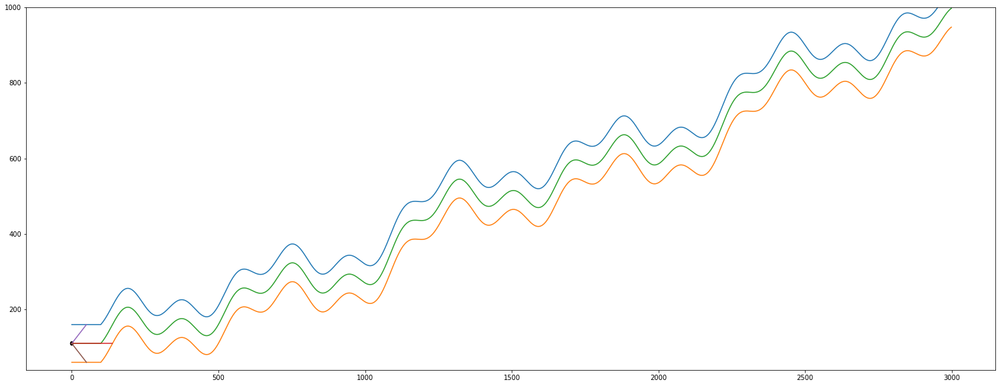

In [5]:
road = Road(wide = 100)
auto = Car(road)

auto.calculate_distances()
auto.plot()

In [6]:
auto.calculate_distances()

Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------


# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  140
Sensor from left wall =  51
Sensor from right wall =  51
most távolsagra van a felső faltól =  50.0
most távolsagra van az alsó faltól =  50.0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  0
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.0
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.0
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  0
			 len(self.sensor_left)   =  0
			 len(self.sensor_center) =  0
			 len(self.sensor_right)  =  0
			 self.x                  =  0
			 -------------- Teszt End --------------
			 ---------------- 

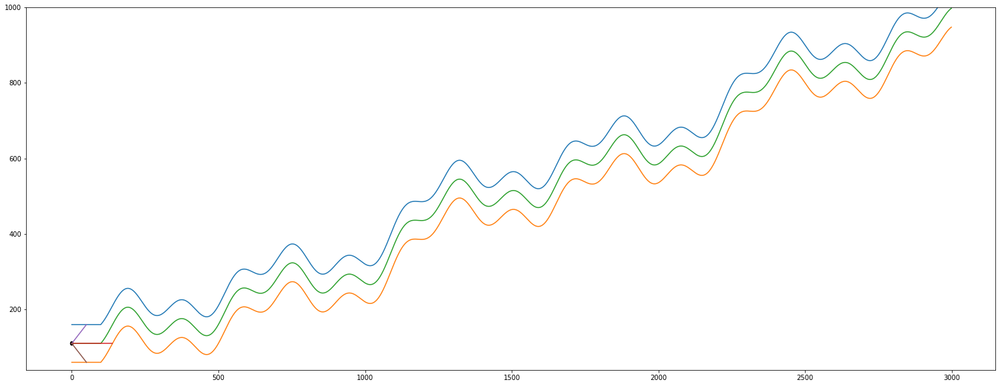

Streaming output truncated to the last 5000 lines.
			 predicted_position_scaled =  [-1.60509915]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 ---------------------
		  action =  -3
		  predicted_position =  [[-3.81529744]]
		  distance from 0 (tmp)=  [[3.81529744]]
		 ---------------------
		 adott j-re -3 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -2
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[52 -2]]
		 _X_center =  [[97 -2]]
		 _X_right  =  [[50 -2]]
		 predicted_left   =  [[54.]]
		 predicted_center =  [[95.37817282]]

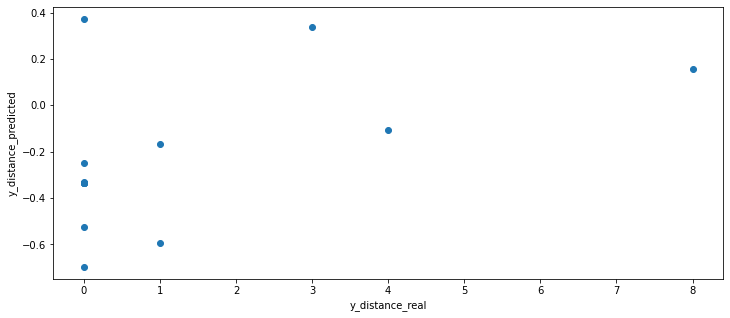

(65, 1)
(65, 1)


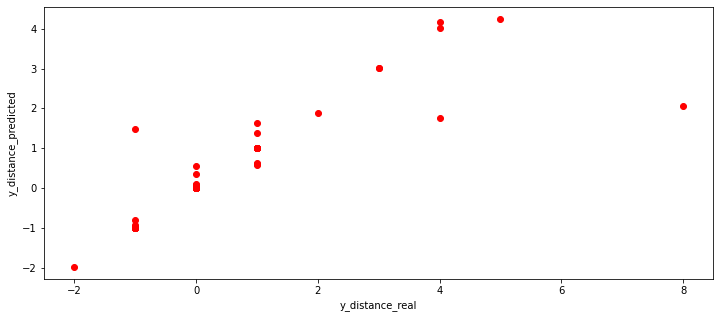

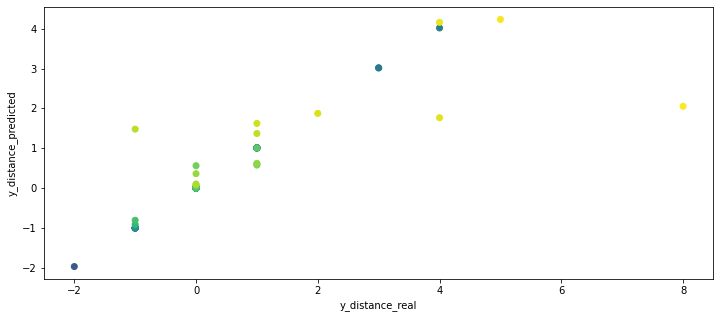

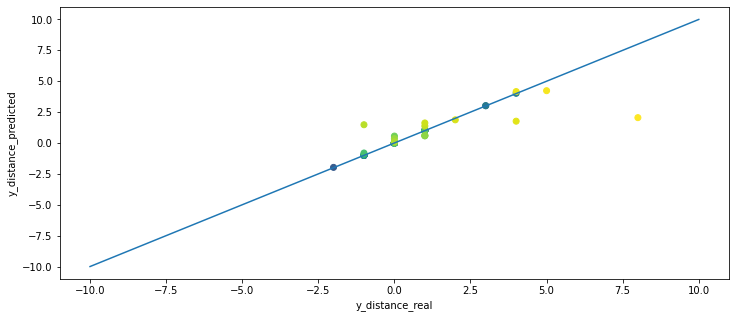

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
118.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  81
Sensor from left wall =  137
Sensor from right wall =  47
most távolsagra van a felső faltól =  42.0
most távolsagra van az alsó faltól =  58.0
cccccccccccccccccccccccccccccc

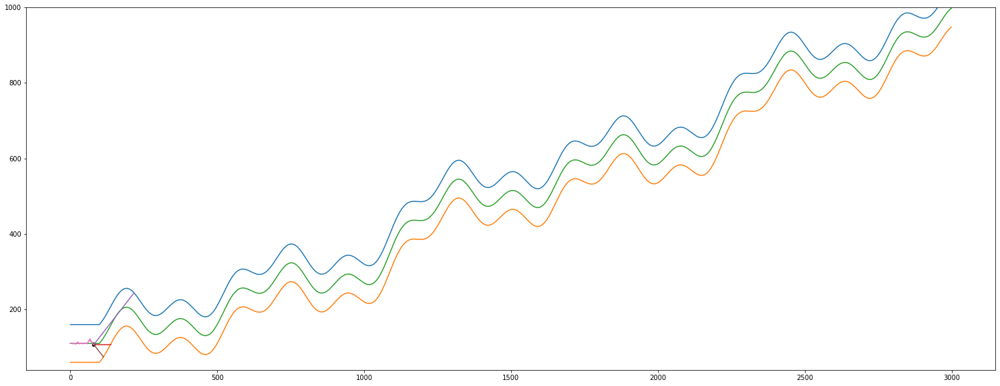

Streaming output truncated to the last 5000 lines.
 [  1.  -1.   1.   1.]
 [ -1.   1.  -1.  -1.]
 [  1.  -1.   1.   1.]
 [  1.  -1.   1.   1.]
 [ -1.   1.  -1.  -1.]
 [  1. -94.   1.   1.]
 [  0.   0.   0.   0.]
 [ -1.   1.  -1.  -1.]
 [  0.   0.   0.   0.]
 [ -1.   1.  -1.  -1.]
 [  2.  -1.   2.   1.]
 [  1.   0.   0.   0.]
 [  2.  -1.   2.   1.]
 [  1.   0.   1.   1.]
 [  3.  -2.   2.   2.]
 [ -1.   0.  -1.  -1.]
 [  5.  -4.   4.   2.]
 [ -1.   1.  -1.   0.]
 [ -5.   4.  -4.  -2.]
 [  1.  -1.   1.   0.]
 [ -4.   3.  -3.  -2.]
 [  1.  -1.   1.   0.]
 [ -4.   2.  -3.  -2.]
 [ -1.   1.  -1.  -1.]
 [ -2.   1.  -1.  -1.]
 [ -1.   1.  -1.  -1.]
 [  1.  -1.   1.   0.]
 [  1.   0.   1.   0.]
 [  2.  -1.   1.   1.]
 [  1.   0.   1.   0.]
 [  2.  -1.   1.   0.]
 [ -1.   1.  -1.   0.]
 [  4.  -2.   3.   2.]
 [ -1.   1.   0.  -1.]
 [  2.  -1.   1.   1.]
 [  1.   0.   1.   0.]
 [ -5.   3.  -4.  -2.]
 [  1.  -1.   1.   1.]
 [ -5.   2.  -4.  -2.]
 [ -1.   1.   0.  -1.]
 [  0.   0.   0.   0.]
 [ -1.

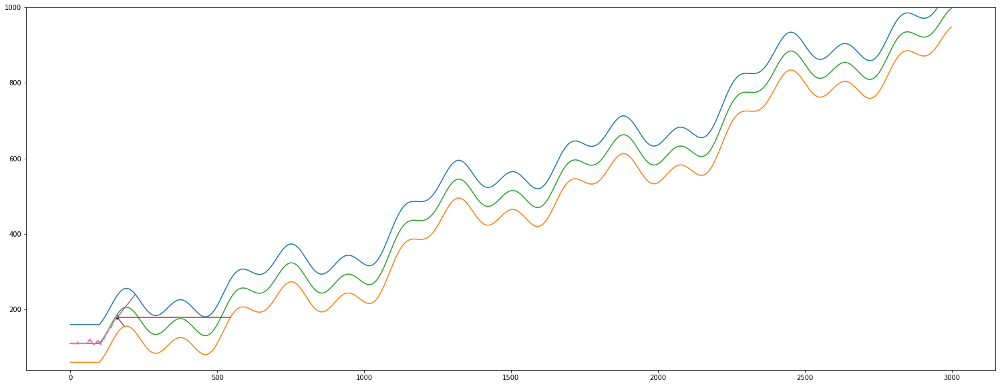

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  160
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 62 386  25]]
actual predicted =  [-0.46716965]
actual self.y_distance[-1] =  -8.678047558086774
len(self.y_distance_real)      =  47
len(self.y_distance_predicted) =  47


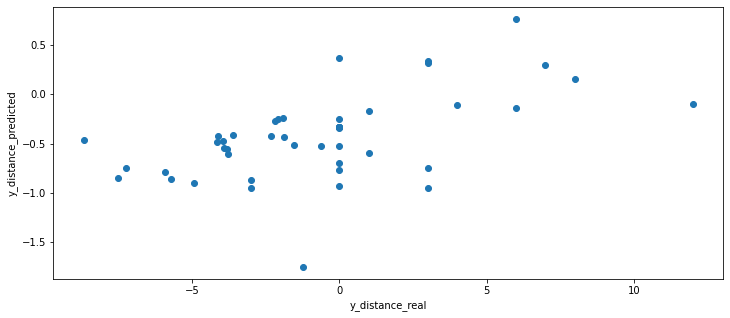

(161, 1)
(161, 1)


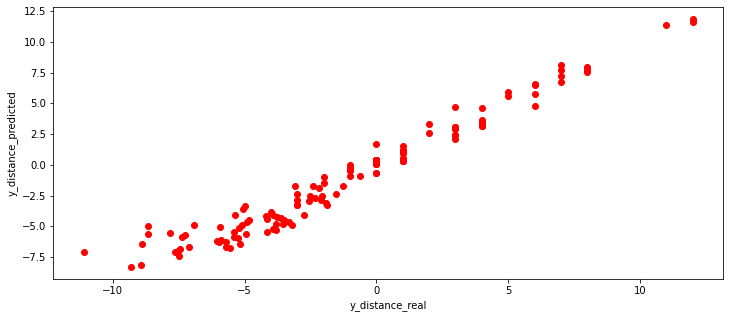

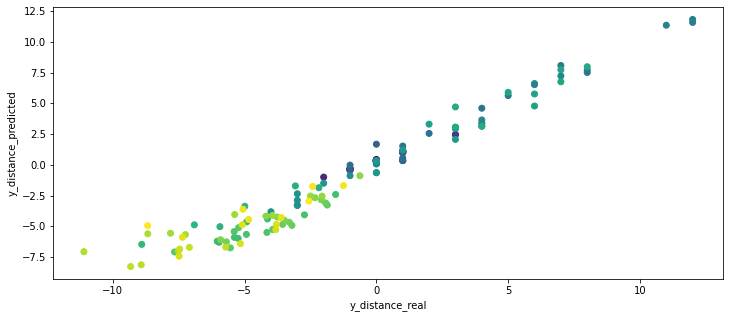

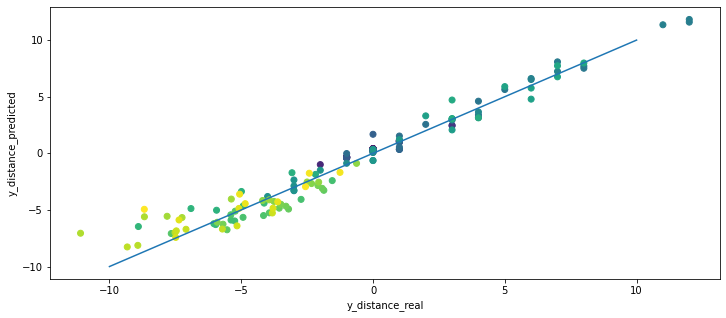

Streaming output truncated to the last 5000 lines.
		 _X_left   =  [[29  1]]
		 _X_center =  [[229   1]]
		 _X_right  =  [[94  1]]
		 predicted_left   =  [[28.12783282]]
		 predicted_center =  [[220.53880449]]
		 predicted_right  =  [[92.49435343]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.98927277 -0.56107765]]
		 regression_center.coef_ =  [[ 0.98069847 -4.04114606]]
		 regression_right.coef_  =  [[0.9700172  1.31273656]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 28.12783282 220.53880449  92.49435343]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-11.96759103]]
		 predicted_position n

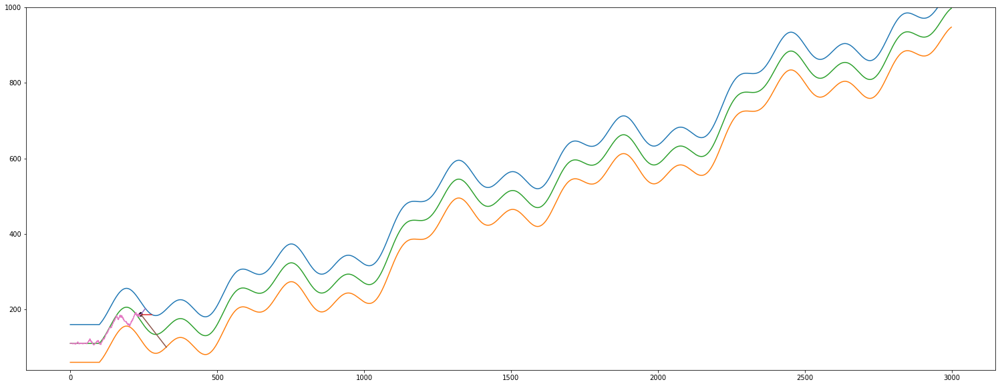

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  240
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (241, 3)
y.shape =  (241, 1)
i       =  240
---------------------
X.max =  391
X.min =  7
X[:,0].max =  146
X[:,0].min =  16
X[:,1].max =  391
X[:,1].min =  32
X[:,2].max =  98
X[:,2].min =  7
y.max =  17.34323264156842
y.min =  -47.721024506312574
---------------------
X_scaled.shape =  (241, 3)
y_scaled.shape =  (241, 1)
X_scaled.max =  1.0000000000000004
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  1.0
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0000000000000004
X_scaled[:,2].min =  -0.9999999999999999
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  240
  Ha már van elég before after adatun

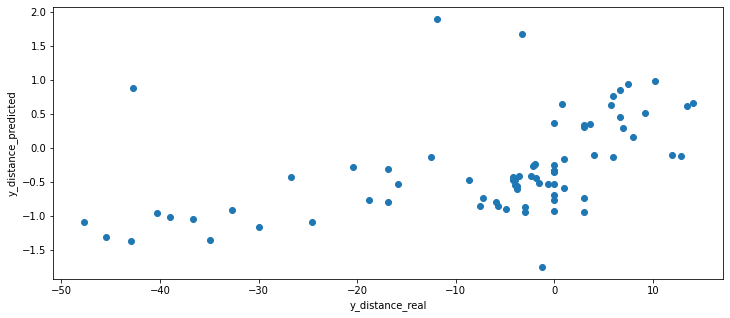

(257, 1)
(257, 1)


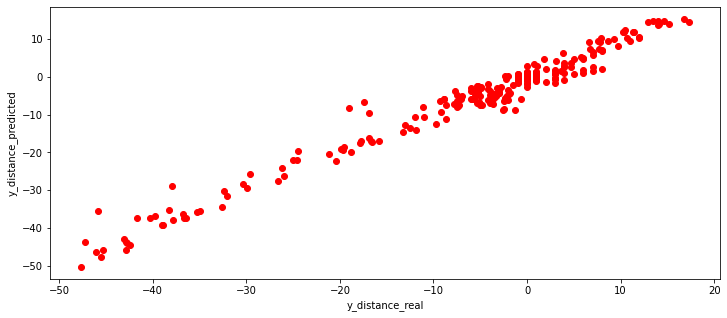

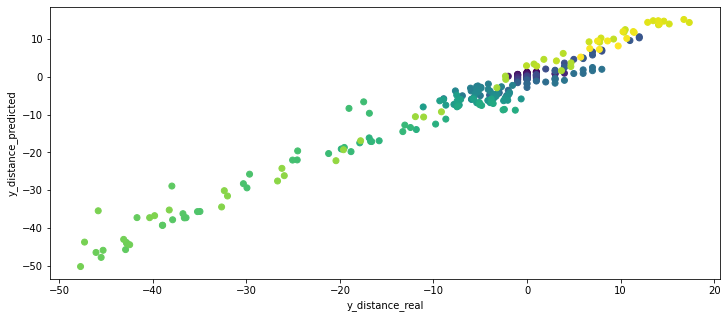

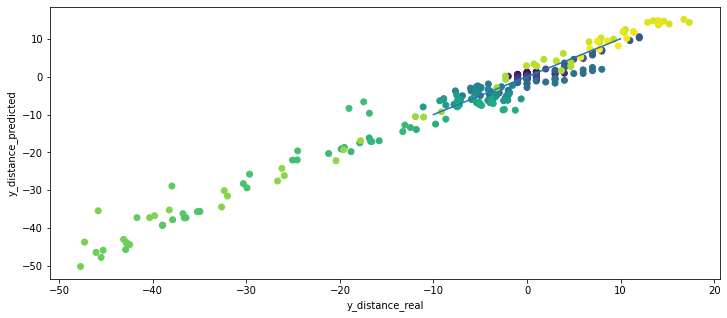

Streaming output truncated to the last 5000 lines.
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  216
Sensor from left wall =  88
Sensor from right wall =  32
most távolsagra van a felső faltól =  49.78279149674381
most távolsagra van az alsó faltól =  50.2172085032562
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  302
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.21720850325618812
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.21720850325618812
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  302
			 len(self.sensor_left)   =  302
			 len(self.sensor_center) =  302
			 len(self.se

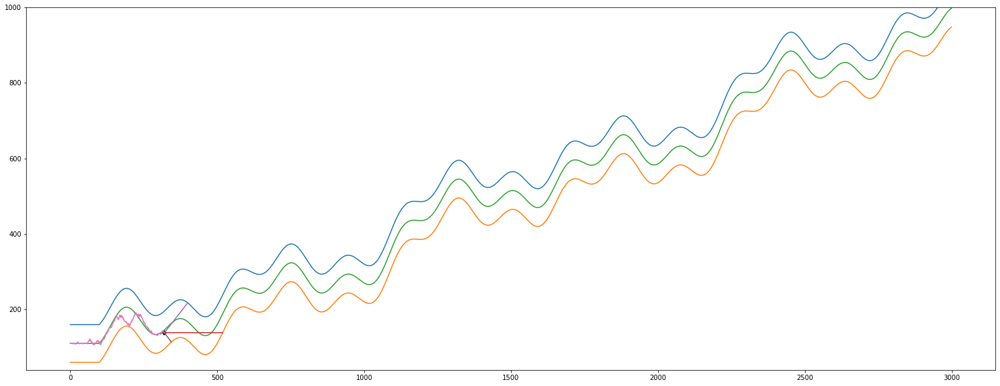

Streaming output truncated to the last 5000 lines.
 [   1.   -1.    1.    1.]
 [   1.   -1.    1.    1.]
 [   2.   -2.    1.    2.]
 [   1.   -1.    1.    1.]
 [  -4.    4.   -3.   -4.]
 [  -1.    1.   -1.   -1.]
 [   1.   -1.    1.    1.]
 [  -1.    1.   -1.   -1.]
 [   1.   -1.    1.    1.]
 [   1.   -1.    1.    1.]
 [  -1.    1.   -1.   -1.]
 [   1.   -1.    1.    1.]
 [  -1.    1.   -1.   -1.]
 [  -1.    1.   -1.   -1.]
 [   1.   -1.    1.    1.]
 [  -1.    1.   -1.   -1.]
 [   1.   -1.    1.    1.]
 [   1.   -1.    1.    1.]
 [  -1.    1.   -1.   -1.]
 [   1.  -94.    1.    1.]
 [   0.    0.    0.    0.]
 [  -1.    1.   -1.   -1.]
 [   0.    0.    0.    0.]
 [  -1.    1.   -1.   -1.]
 [   2.   -1.    2.    1.]
 [   1.    0.    0.    0.]
 [   2.   -1.    2.    1.]
 [   1.    0.    1.    1.]
 [   3.   -2.    2.    2.]
 [  -1.    0.   -1.   -1.]
 [   5.   -4.    4.    2.]
 [  -1.    1.   -1.    0.]
 [  -5.    4.   -4.   -2.]
 [   1.   -1.    1.    0.]
 [  -4.    3.   -3.   -2.]
 [  

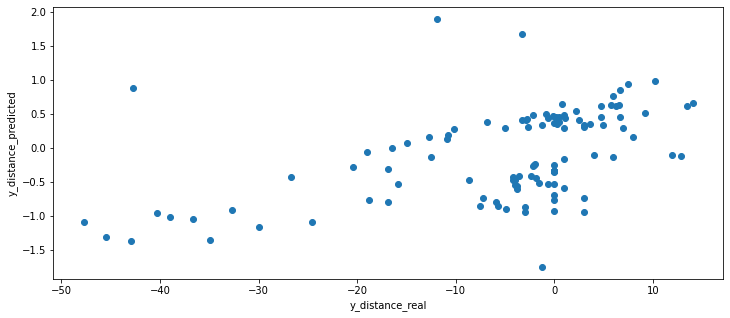

(353, 1)
(353, 1)


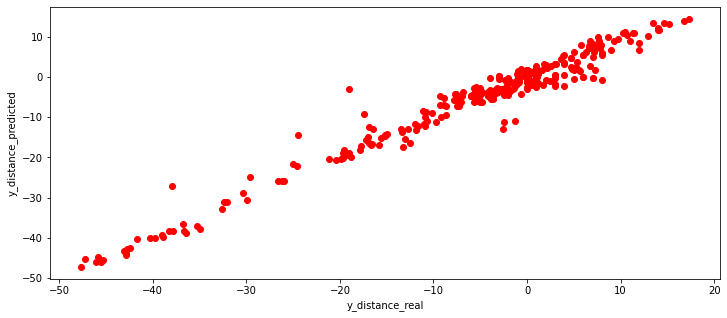

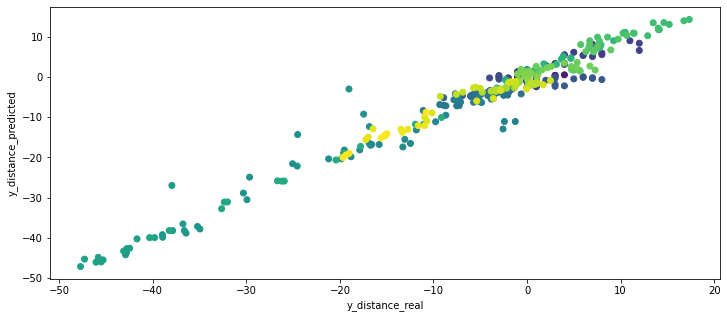

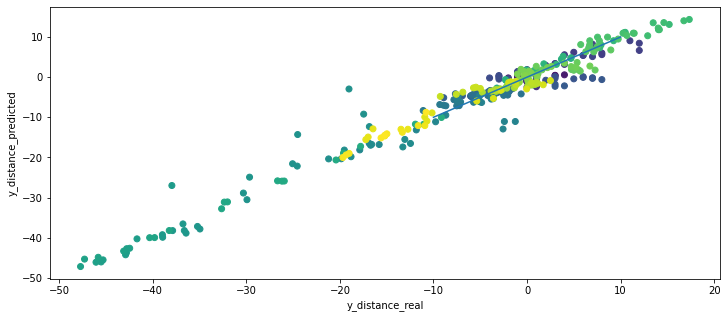

Streaming output truncated to the last 5000 lines.
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
150.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  150
Sensor from left wall =  48
Sensor from right wall =  66
most távolsagra van a felső faltól =  75.77628355549876
most távolsagra van az alsó faltól =  24.223716444501235
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  377
cccccccccccccccccccccccccccccccccccccccc

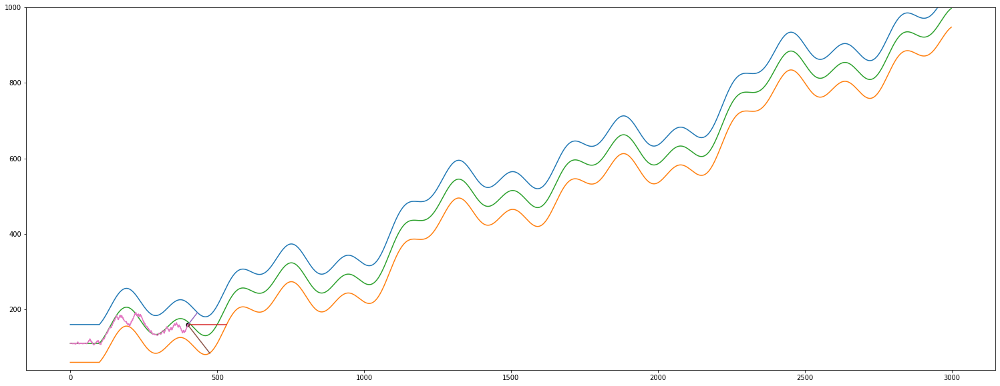

Streaming output truncated to the last 5000 lines.
self.x                       =  423
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  3.6372107507549174
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  3.6372107507549174
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  424
			 len(self.sensor_left)   =  424
			 len(self.sensor_center) =  424
			 len(self.sensor_right)  =  424
			 self.x                  =  423
			 -------------- Teszt End --------------
self.y új értéke   =  153.0
action             =  -2
----------------- módosítás vége -----------------
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz

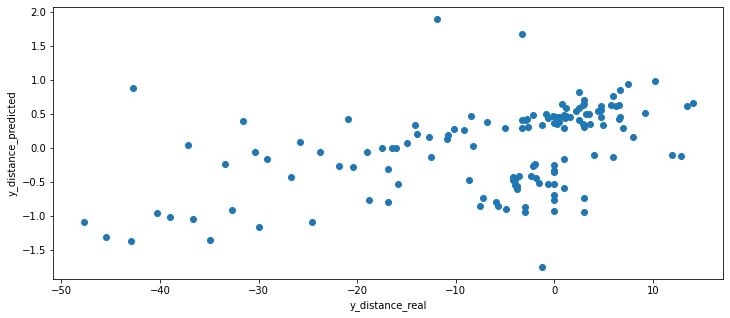

(449, 1)
(449, 1)


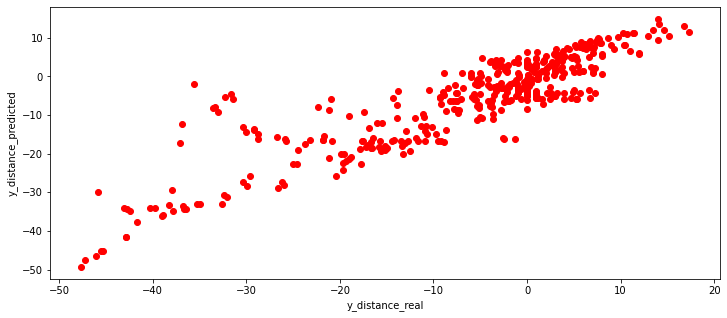

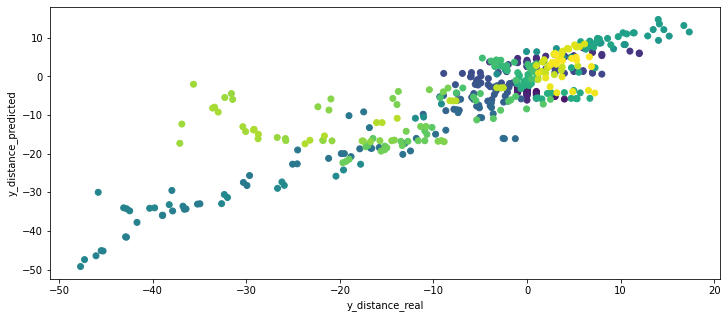

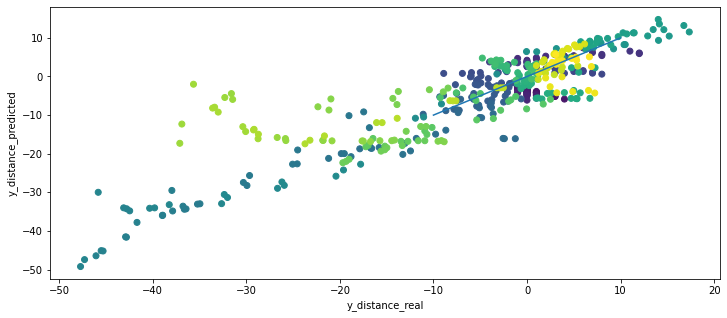

Streaming output truncated to the last 5000 lines.
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  4.163779717480367
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  456
			 len(self.sensor_left)   =  456
			 len(self.sensor_center) =  456
			 len(self.sensor_right)  =  456
			 self.x                  =  456
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  457
			 len(self.sensor_left)   =  457
			 len(self.sensor_center) =  457
			 len(self.sensor_right)  =  457
			 self.x                  =  456
			 -------------- Append End --------------
------------------------------ IF i % 3 == 0 ------------------------------
# i =  456
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (457, 3)
y.shape =  (457, 1)
i       =  4

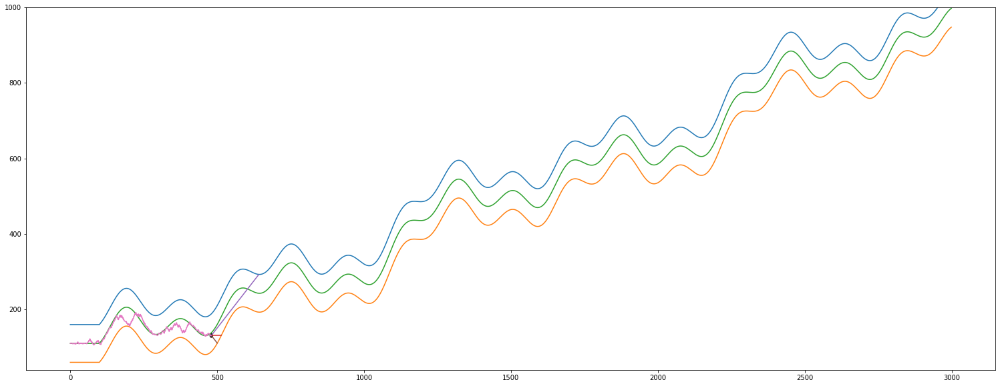

Streaming output truncated to the last 5000 lines.
		 predicted_center =  [[37.6803172]]
		 predicted_right  =  [[10.47011363]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99611408 -0.70547075]]
		 regression_center.coef_ =  [[ 0.97982623 -3.29616535]]
		 regression_right.coef_  =  [[0.98975913 1.09406834]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[116.37888848  37.6803172   10.47011363]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-2.47493507]]
		 predicted_position neural net model scaled =  [-0.22078372]
		 predicted_position neural net model inverz =  [[-22.37146026]]
			 xxxxxxxxxxxx

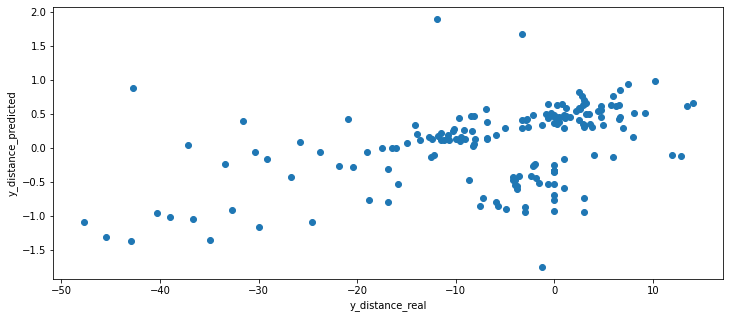

(545, 1)
(545, 1)


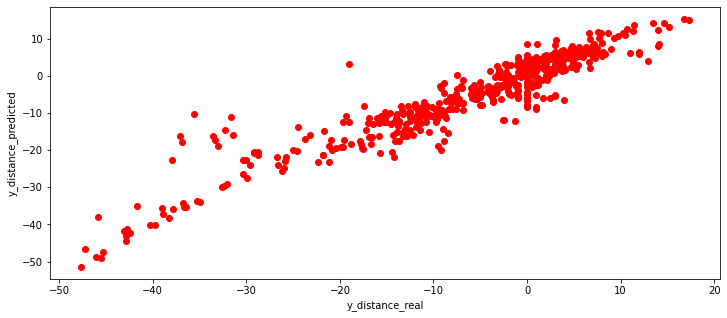

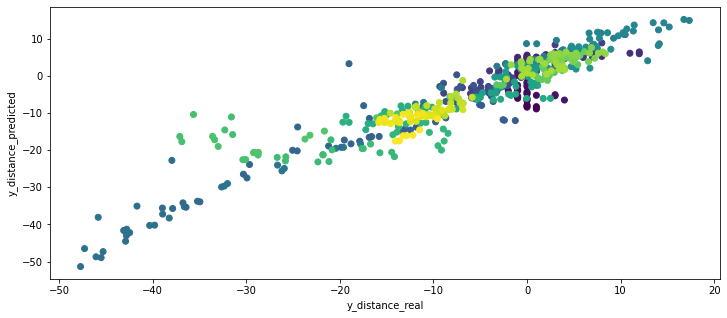

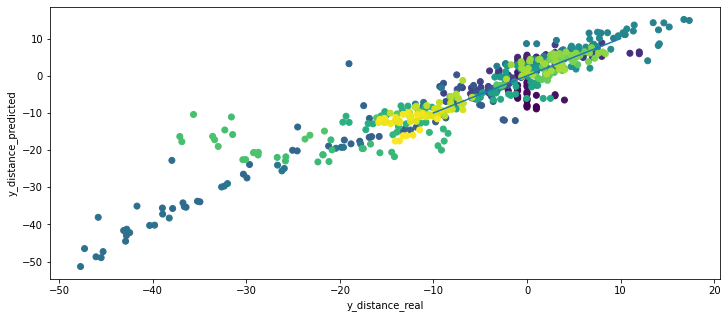

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
218.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  144
Sensor from left wall =  79
Sensor from right wall =  20
most távolsagra van a felső faltól =  60.896208625572854
most távolsagra van az alsó faltól =  39.103791374427175
cc

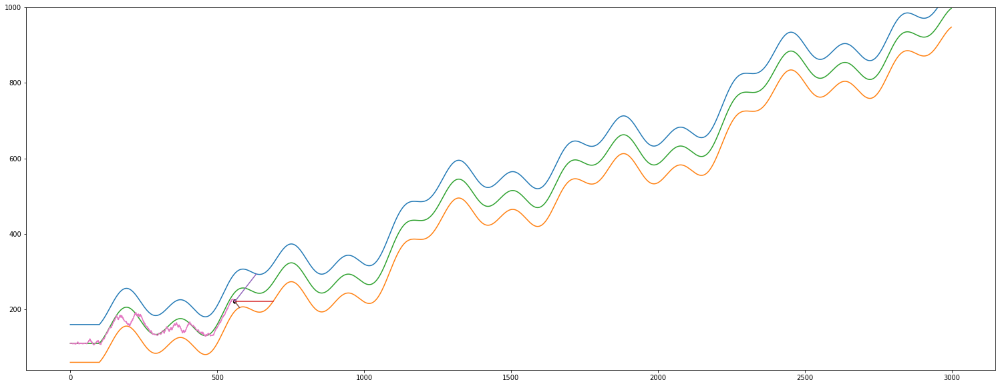

Streaming output truncated to the last 5000 lines.
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
251.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  100
Sensor from left wall =  48
Sensor from right wall =  52
most távolsagra van a felső faltól =  48.33867724069188
most távolsagra van az alsó faltól =  51.66132275930812
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  617
ccccccccccccccccccccccccccccccccccccccccc

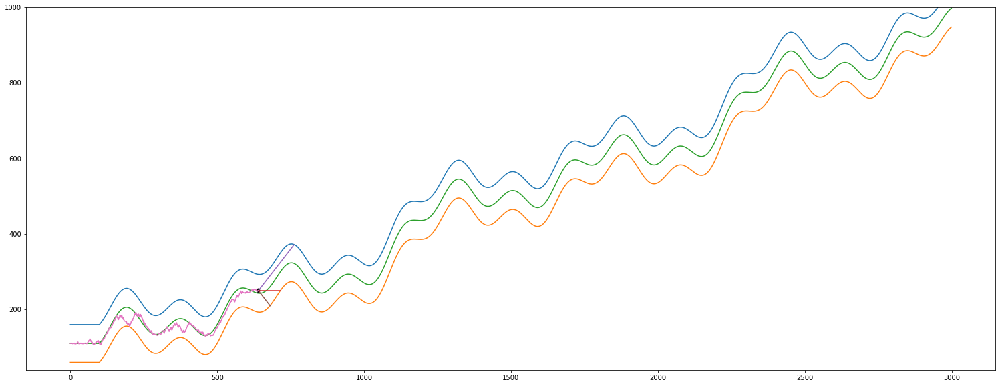

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  640
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[122  76  41]]
actual predicted =  [0.51422791]
actual self.y_distance[-1] =  6.9806171618877215
len(self.y_distance_real)      =  207
len(self.y_distance_predicted) =  207


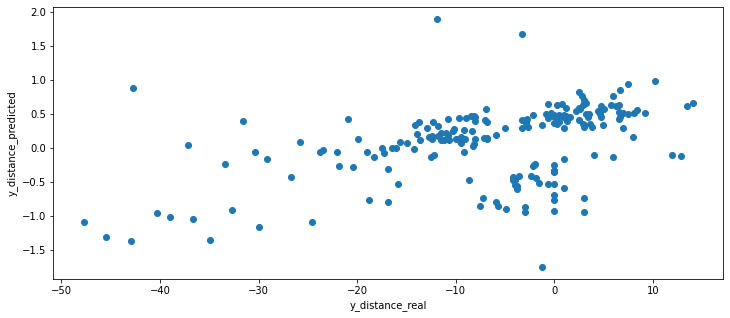

(641, 1)
(641, 1)


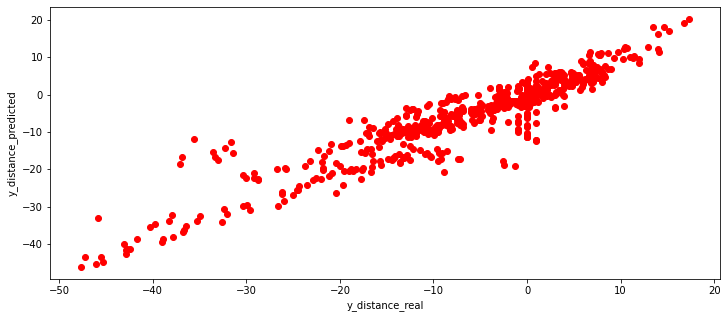

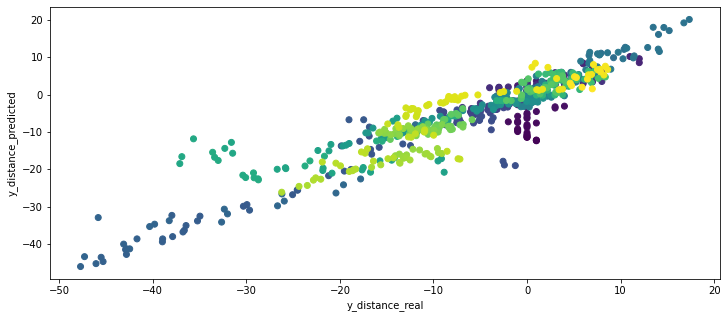

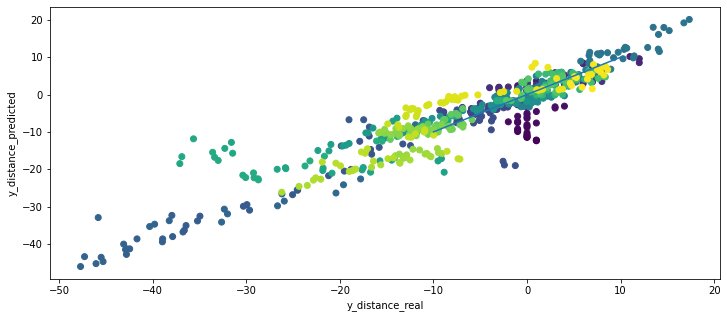

Streaming output truncated to the last 5000 lines.
 [  1.  -1. 328.   0.]]
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------------------------------------------------------------
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_left.coef_ =  [[ 0.99720749 -0.7173925 ]]
		 regression_left.intercept_ =  0.0
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98422106 -2.15775634]]
		 regression_center.intercept_ 0.0
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99063263 1.02398688]]
		 regression_right.intercept_ =  0.0
	 # Az egyes lépések várható kimeneteinek kiszámolása -------------------

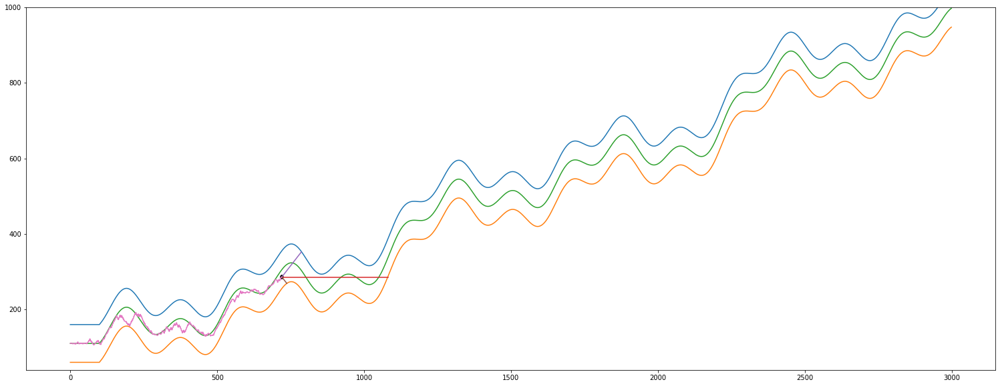

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  720
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (721, 3)
y.shape =  (721, 1)
i       =  720
---------------------
X.max =  391
X.min =  7
X[:,0].max =  167
X[:,0].min =  16
X[:,1].max =  391
X[:,1].min =  24
X[:,2].max =  98
X[:,2].min =  7
y.max =  17.34323264156842
y.min =  -47.721024506312574
---------------------
X_scaled.shape =  (721, 3)
y_scaled.shape =  (721, 1)
X_scaled.max =  1.0000000000000004
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0000000000000002
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  0.9999999999999998
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0000000000000004
X_scaled[:,2].min =  -0.9999999999999999
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  720
  Ha má

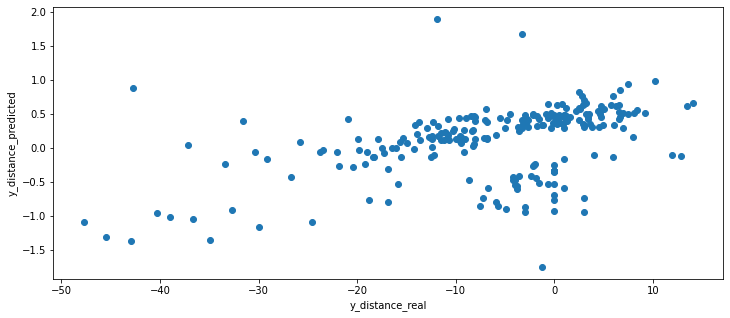

(737, 1)
(737, 1)


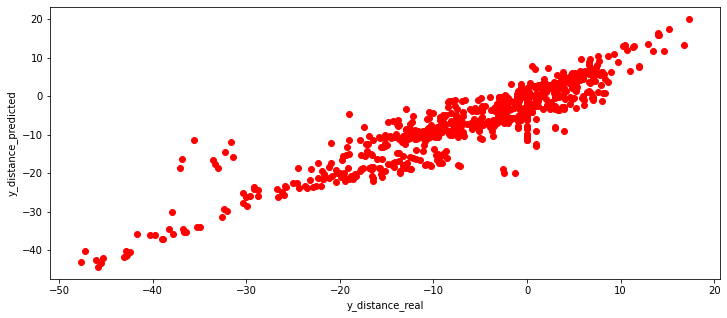

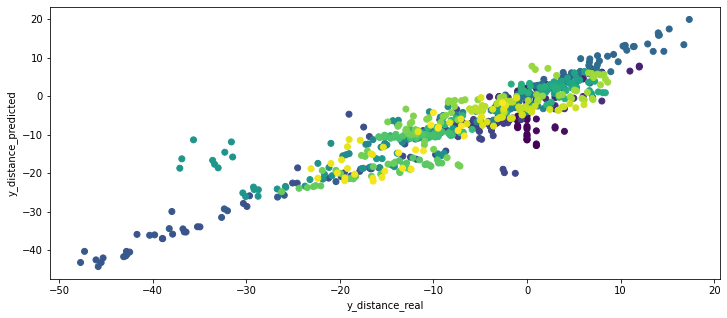

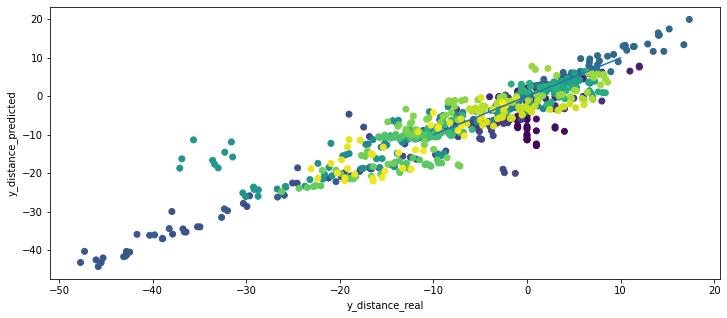

Streaming output truncated to the last 5000 lines.
		 --------------------------------------------------------------------------------------------------------------------------------------
	 minden j-re kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------

------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  317.0
Sensor center =  48
Sensor from left wall =  26
Sensor from right wall =  110
most távolsagra van a felső faltól =  52.00050629390921
most távolsagra van az alsó faltól =  47.99949370609079
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  774
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -2.0005062939092113
KKKKKKKKKKKKKKKK

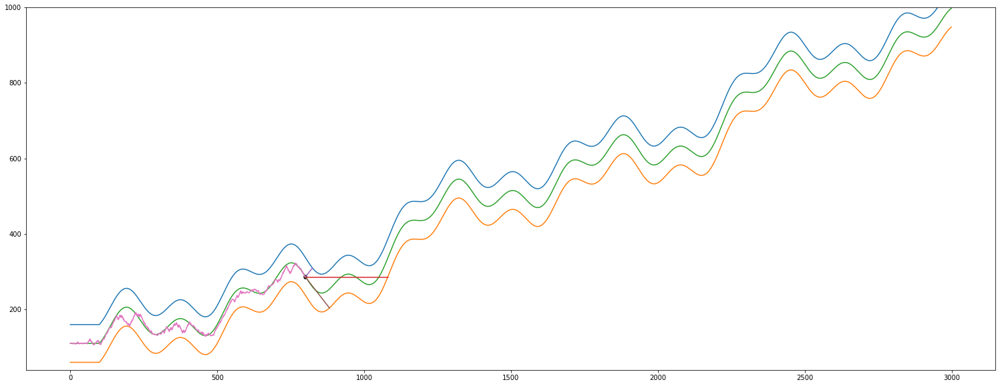

Streaming output truncated to the last 5000 lines.
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  1
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  1
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  271
Sensor from left wall =  23
Sensor from right wall =  77
most távolsagra van a felső faltól =  46.9259305040689
most távolsagra van az alsó faltól =  53.0740694959311
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  808
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK

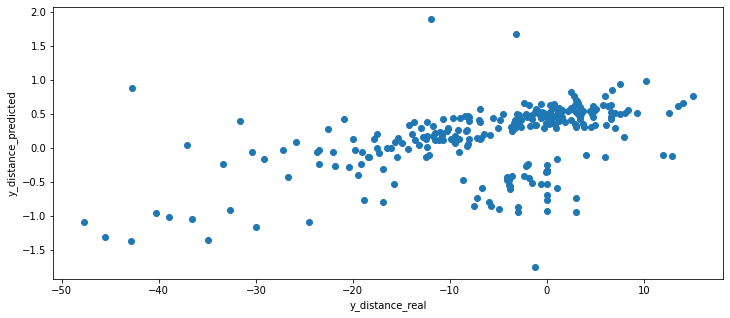

(833, 1)
(833, 1)


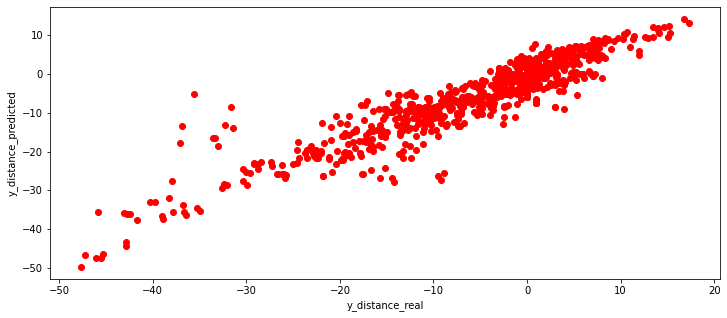

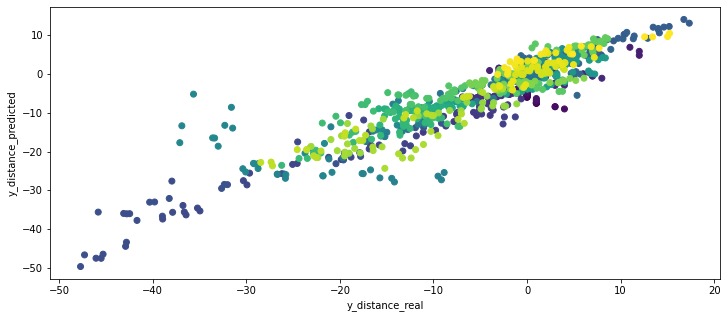

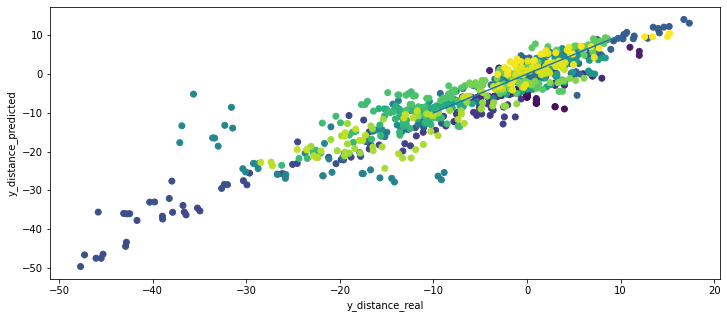

Streaming output truncated to the last 5000 lines.
			 -------------- Append End --------------
------------------------------ IF i % 3 == 1 ------------------------------
# i =  856
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 89 209  41]]
actual predicted =  [0.49061557]
actual self.y_distance[-1] =  11.482752733121629
len(self.y_distance_real)      =  279
len(self.y_distance_predicted) =  279
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
255.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++

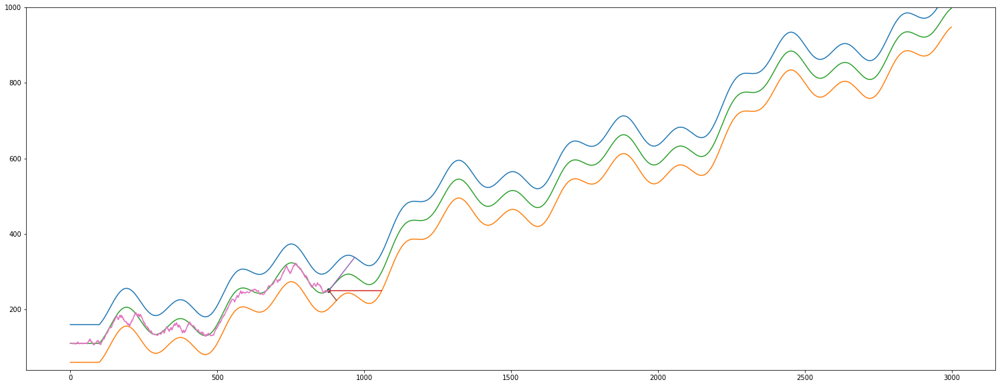

Streaming output truncated to the last 5000 lines.
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  906
			 len(self.sensor_left)   =  906
			 len(self.sensor_center) =  906
			 len(self.sensor_right)  =  906
			 self.x                  =  905
			 -------------- Append End --------------
------------------------------ IF i % 3 == 2 ------------------------------
# i =  905
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  168
Sensor from left wall =  67
Sensor from right wall =  29
most távolsagra van a felső faltól =  53.97181903678626
most távolsagra van az alsó faltól =  46.02818096321374
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  905
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distan

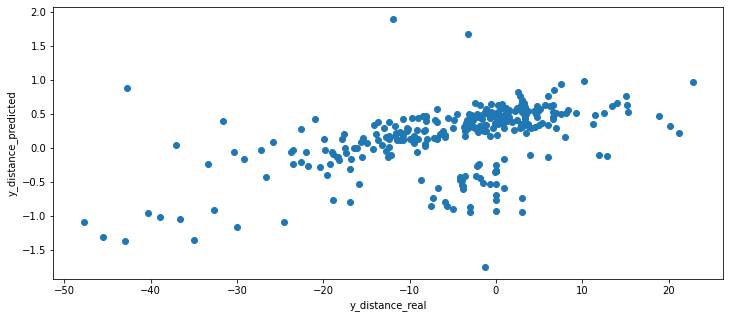

(929, 1)
(929, 1)


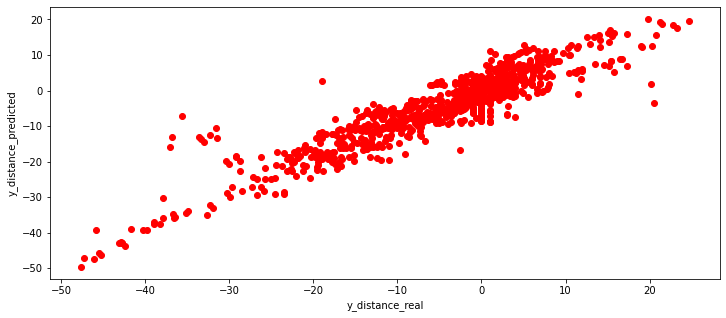

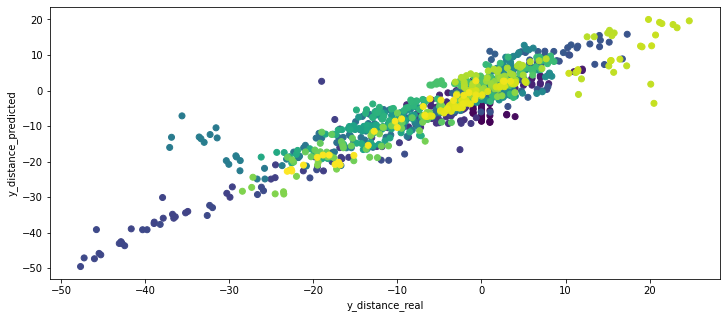

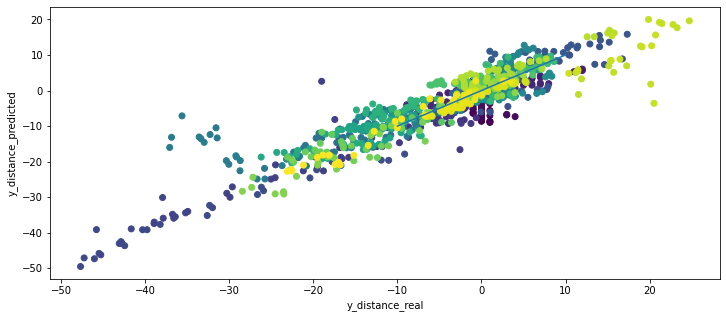

Streaming output truncated to the last 5000 lines.
		 _X_right  =  [[58 -4]]
		 predicted_left   =  [[51.74915316]]
		 predicted_center =  [[145.6215526]]
		 predicted_right  =  [[53.84604105]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99780099 -0.71422613]]
		 regression_center.coef_ =  [[ 0.98010606 -1.61162301]]
		 regression_right.coef_  =  [[0.99722865 0.99830509]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 51.74915316 145.6215526   53.84604105]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-4.35590994]]
		 predicted_position neural net model scaled =  [0.08245146]
		 predicted_posi

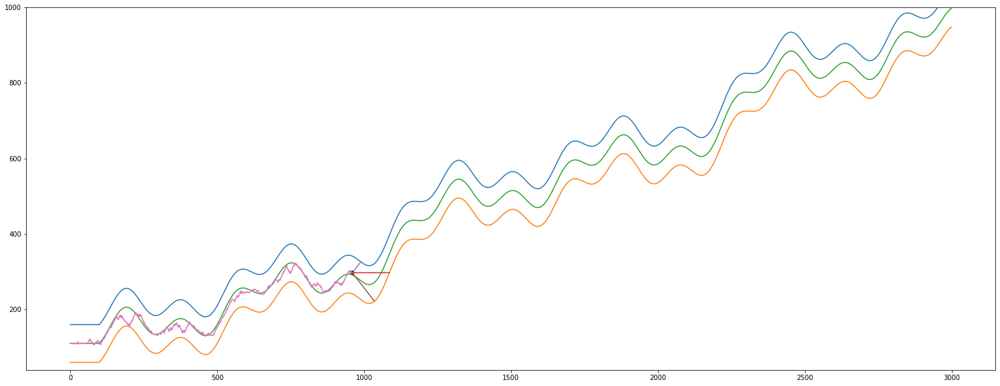

Streaming output truncated to the last 5000 lines.
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[203.47080459  71.68922174  52.80905048]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-3.81051539]]
		 predicted_position neural net model scaled =  [0.36743309]
		 predicted_position neural net model inverz =  [[1.814035]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[ 0.95282088 -0.74011323 -0.21693931]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [0.36743309]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 -------

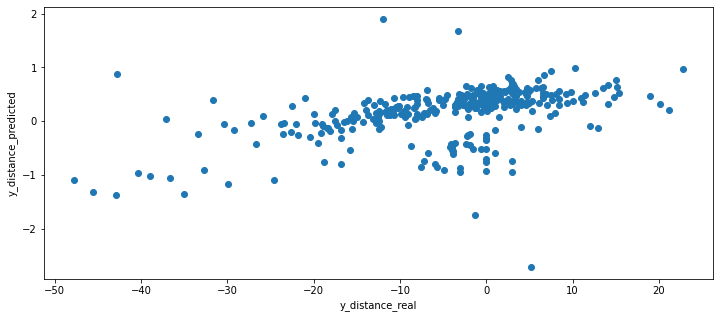

(1025, 1)
(1025, 1)


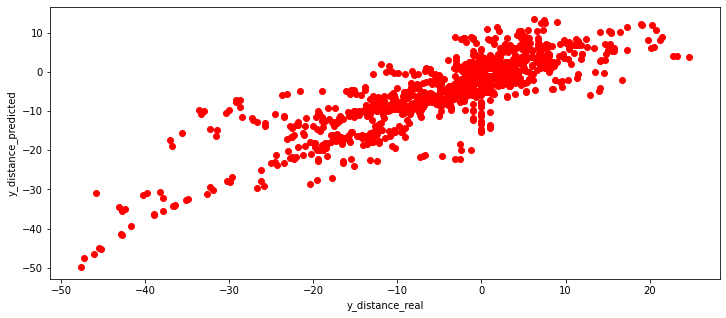

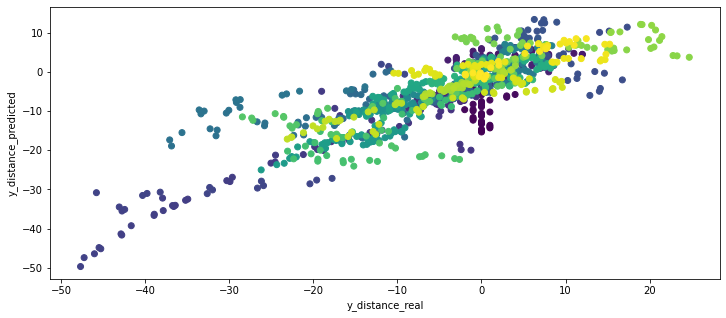

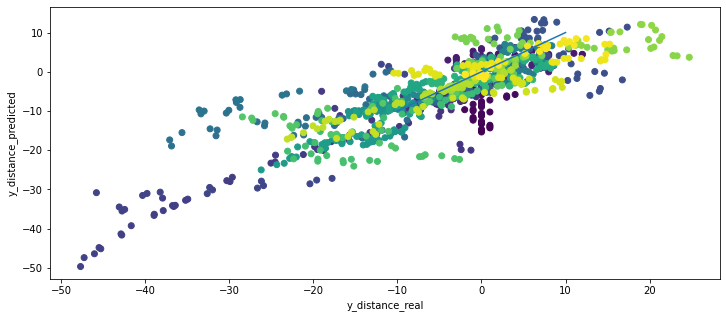

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
267.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  46
Sensor from left wall =  320
Sensor from right wall =  29
most távolsagra van a felső faltól =  49.92084203445722
most távolsagra van az alsó faltól =  50.079157965542805
ccc

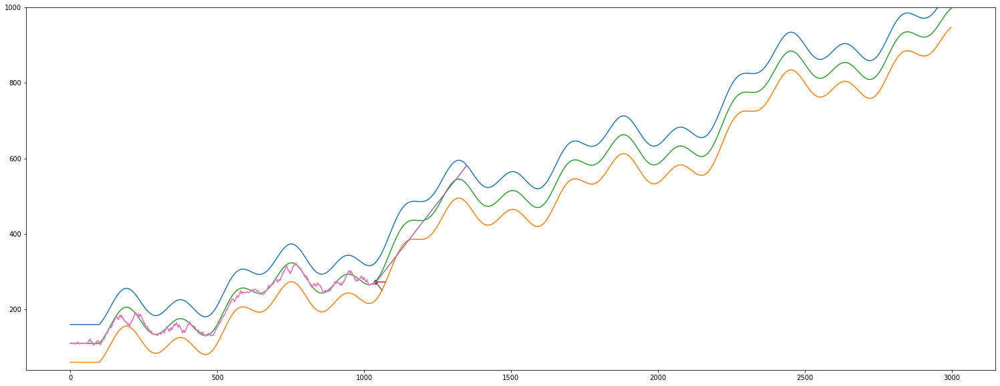

Streaming output truncated to the last 5000 lines.
		 -------------------------X-------------------------
		  [[245.06943654  25.83904012   8.36765758]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-3.12142276]]
		 predicted_position neural net model scaled =  [-0.11460477]
		 predicted_position neural net model inverz =  [[-15.64771455]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[ 0.48746387 -0.96323097 -0.97662124]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [-0.11460477]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 ---------------------
		  action =  -5
		  p

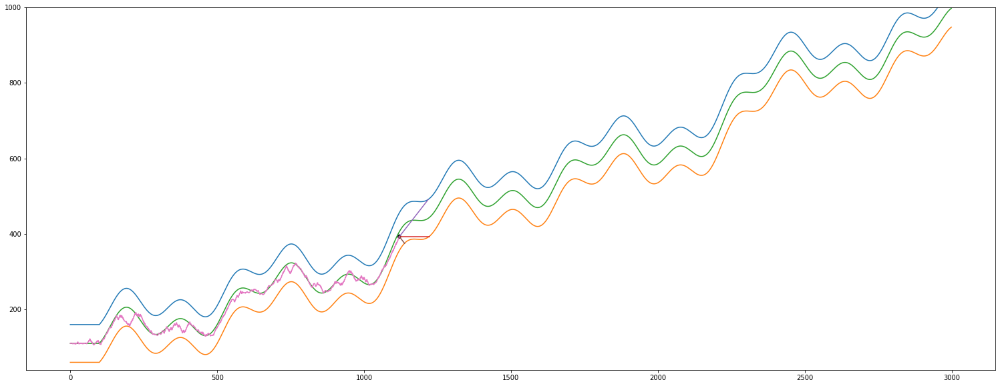

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  1120
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 99 103  19]]
actual predicted =  [-0.10098497]
actual self.y_distance[-1] =  -13.106392667115188
len(self.y_distance_real)      =  367
len(self.y_distance_predicted) =  367


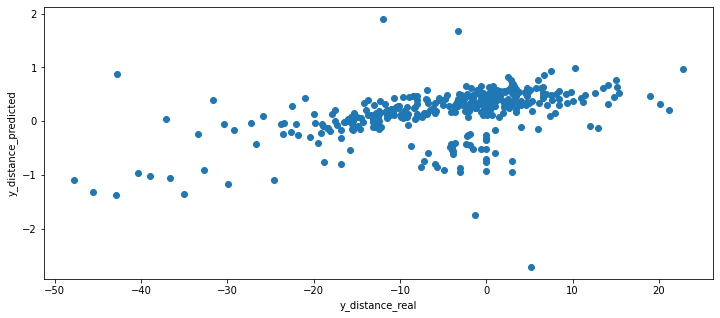

(1121, 1)
(1121, 1)


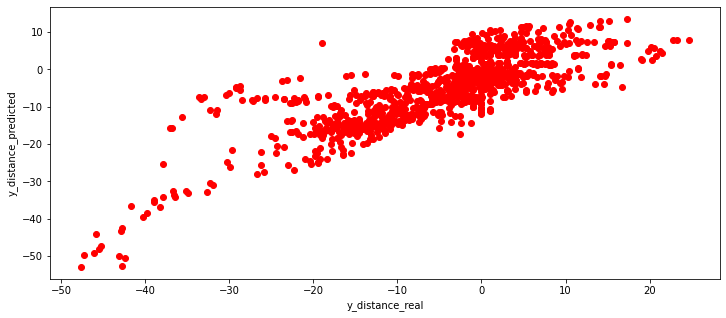

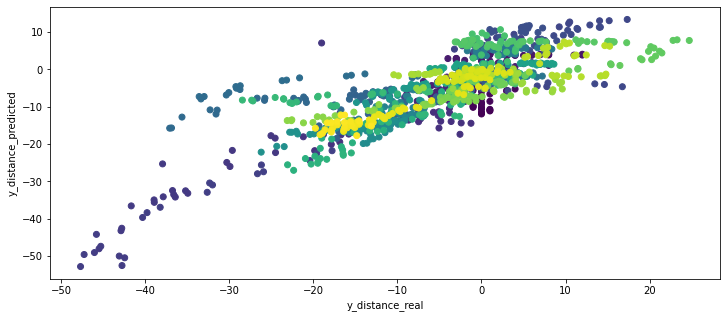

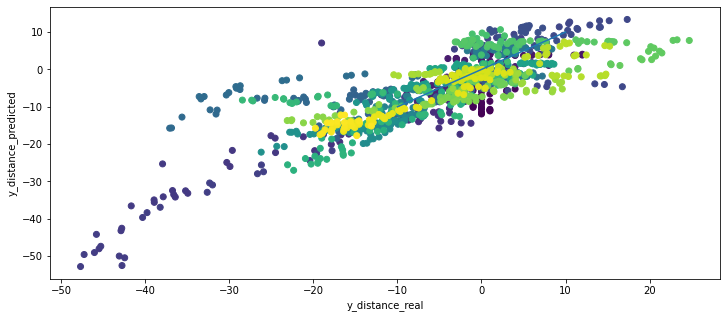

Streaming output truncated to the last 5000 lines.
#    self.y :
453.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  99
Sensor from left wall =  36
Sensor from right wall =  55
most távolsagra van a felső faltól =  33.35190316434182
most távolsagra van az alsó faltól =  66.64809683565818
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1175
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKK

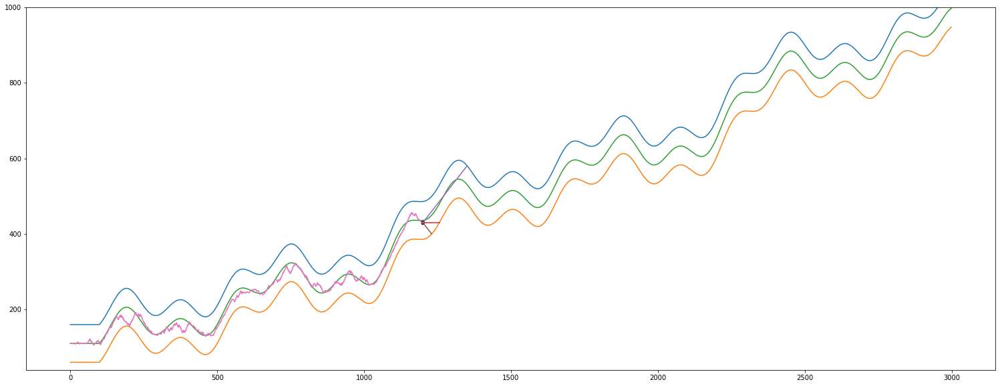

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  1200
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (1201, 3)
y.shape =  (1201, 1)
i       =  1200
---------------------
X.max =  391
X.min =  7
X[:,0].max =  324
X[:,0].min =  16
X[:,1].max =  391
X[:,1].min =  19
X[:,2].max =  124
X[:,2].min =  7
y.max =  24.728676669584956
y.min =  -47.721024506312574
---------------------
X_scaled.shape =  (1201, 3)
y_scaled.shape =  (1201, 1)
X_scaled.max =  1.0000000000000004
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  1.0000000000000004
X_scaled[:,1].min =  -0.9999999999999999
X_scaled[:,2].max =  1.0
X_scaled[:,2].min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  1200
  Ha már van elég before aft

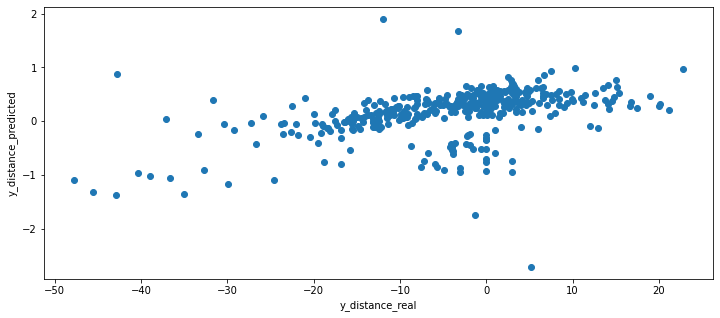

(1217, 1)
(1217, 1)


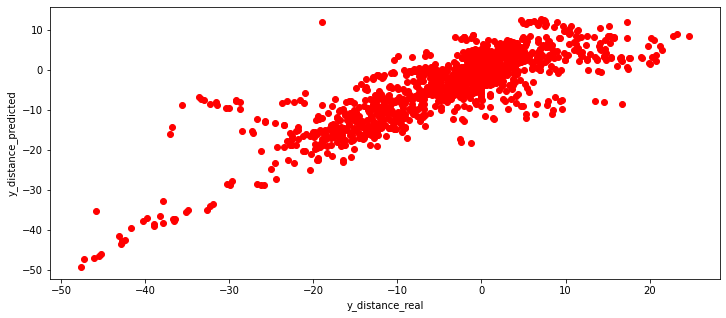

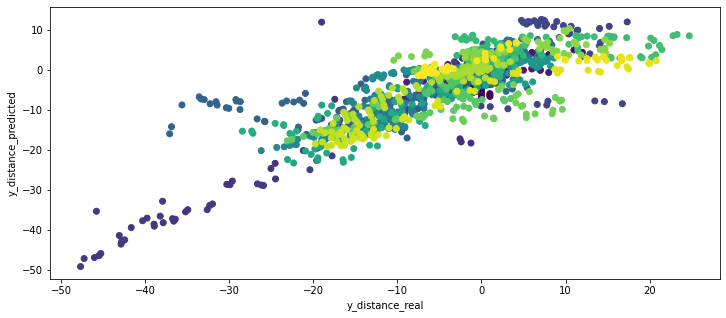

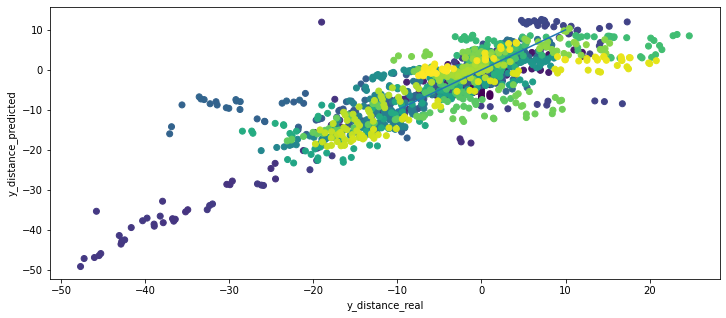

Streaming output truncated to the last 5000 lines.
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-2.30286959]]
		 predicted_position neural net model scaled =  [-0.34113689]
		 predicted_position neural net model inverz =  [[-23.85380694]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.43063665 -0.89787982 -0.83893075]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [-0.34113689]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 ---------------------
		  action =  -4
		  predicted_position =  [[-23.85380694]]
		  distance from 0 (tmp)=  [[23.85380694]]
		 -----------------

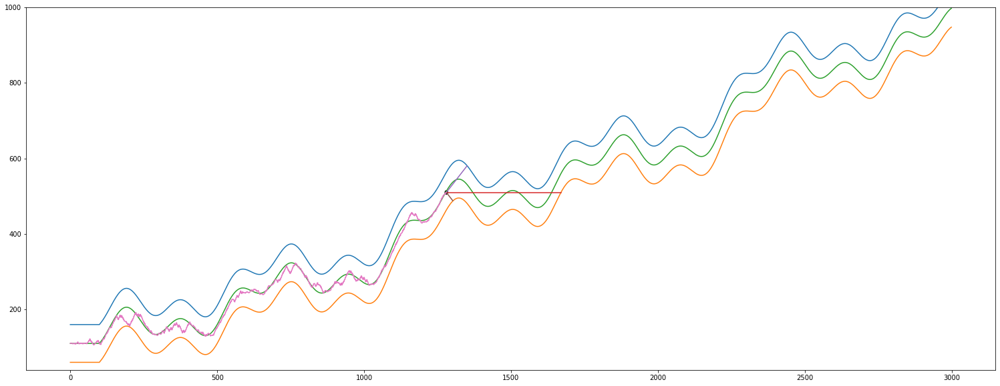

Streaming output truncated to the last 5000 lines.
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -7.5752342556329495
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -7.5752342556329495
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1288
			 len(self.sensor_left)   =  1288
			 len(self.sensor_center) =  1288
			 len(self.sensor_right)  =  1288
			 self.x                  =  1288
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  1289
			 len(self.sensor_left)   =  1289
			 len(self.sensor_center) =  1289
			 len(self.sensor_right)  =  1289
			 self.x                  =  1288
			 -------------- Append End --------------
------------------------------ IF i % 3 == 1 ------------------------------
# i =  1288
# 2. az 1. pontban megtanult modell alapján 

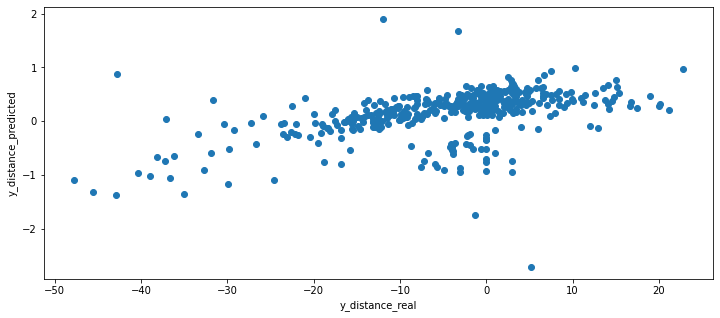

(1313, 1)
(1313, 1)


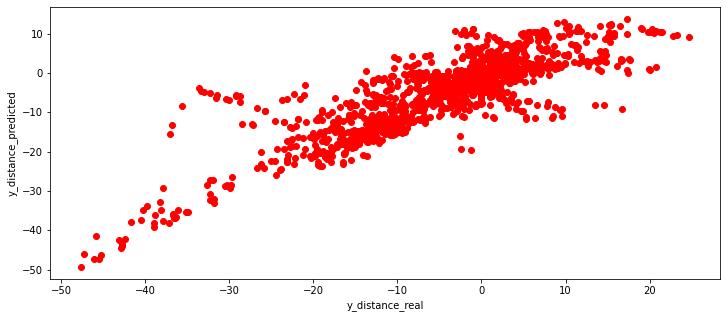

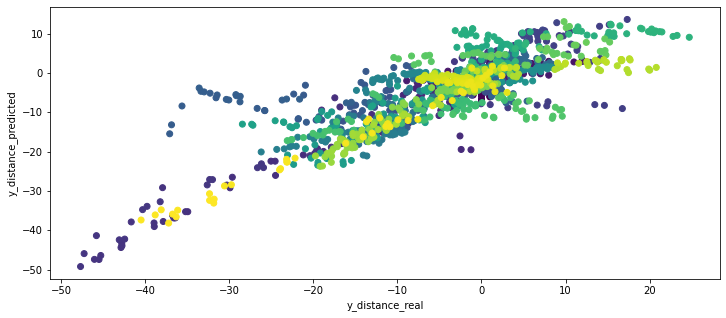

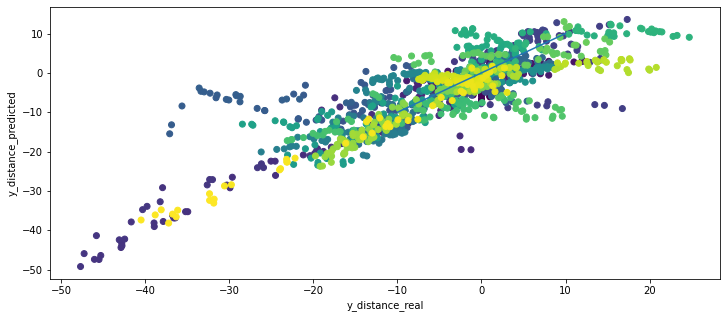

Streaming output truncated to the last 5000 lines.
			 ---------------- Append ----------------
			 len(self.y_distance)    =  1339
			 len(self.sensor_left)   =  1339
			 len(self.sensor_center) =  1339
			 len(self.sensor_right)  =  1339
			 self.x                  =  1338
			 -------------- Append End --------------
------------------------------ IF i % 3 == 0 ------------------------------
# i =  1338
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (1339, 3)
y.shape =  (1339, 1)
i       =  1338
---------------------
X.max =  396
X.min =  7
X[:,0].max =  324
X[:,0].min =  16
X[:,1].max =  396
X[:,1].min =  19
X[:,2].max =  124
X[:,2].min =  7
y.max =  24.728676669584956
y.min =  -47.721024506312574
---------------------
X_scaled.shape =  (1339, 3)
y_scaled.shape =  (1339, 1)
X_scaled.max =  1.0
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  0.999999999

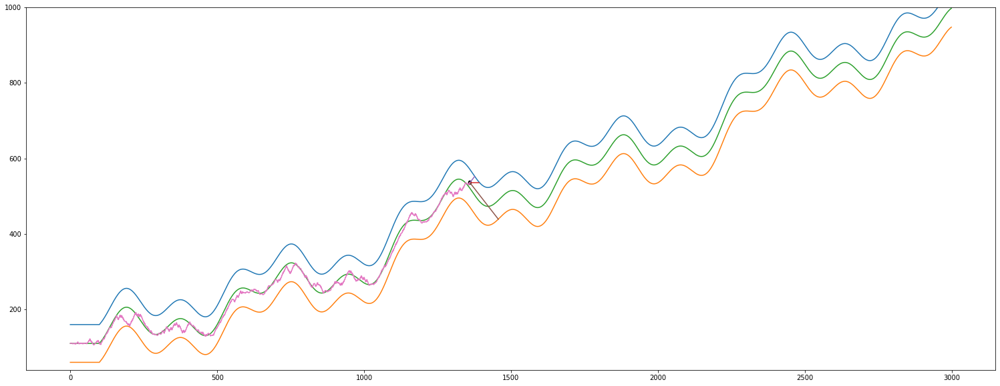

Streaming output truncated to the last 5000 lines.
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[ 3.08337586 13.28240194 88.46590375]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[6.14660146]]
		 predicted_position neural net model scaled =  [0.39187643]
		 predicted_position neural net model inverz =  [[11.15929429]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-1.02471056 -0.99852532  0.39257955]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [0.39187643]
		 --------------------------------------------------------------------------------------------------------------------------------------
		 adott j-

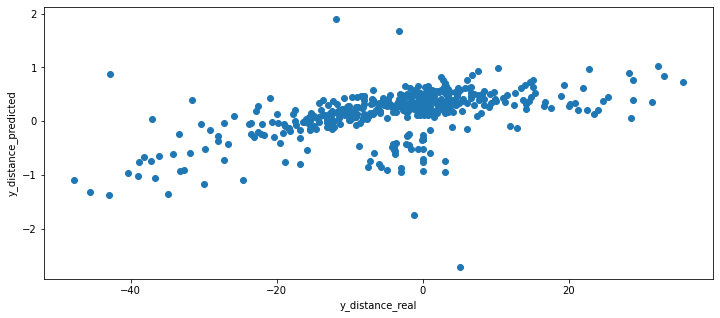

(1409, 1)
(1409, 1)


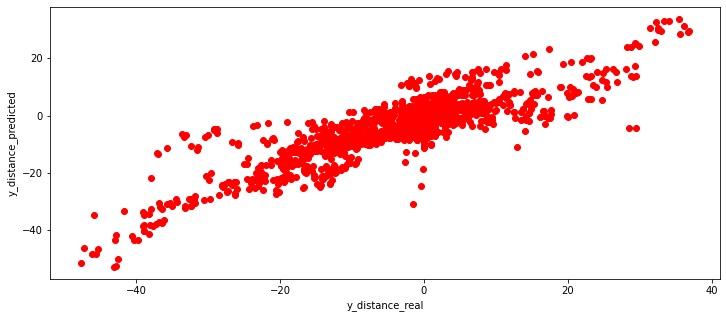

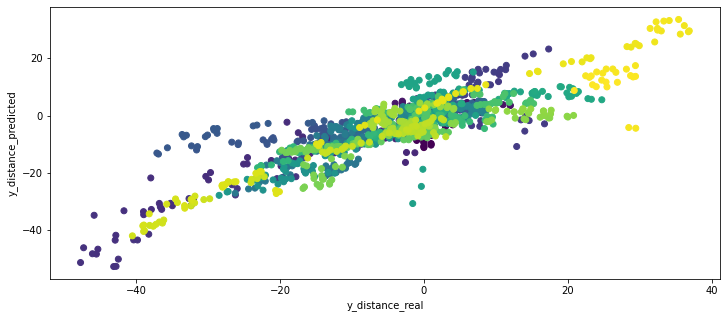

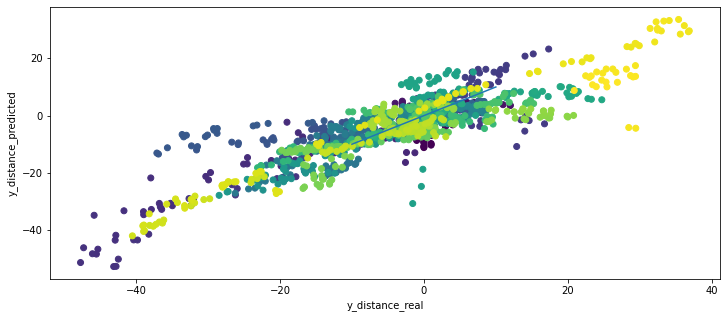

Streaming output truncated to the last 5000 lines.
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
496.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  1
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  246
Sensor from left wall =  52
Sensor from right wall =  51
most távolsagra van a felső faltól =  27.61606867693297
most távolsagra van az alsó faltól =  72.38393132306703
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1416
cccccccccccccccccccccccccccccccccccccccc

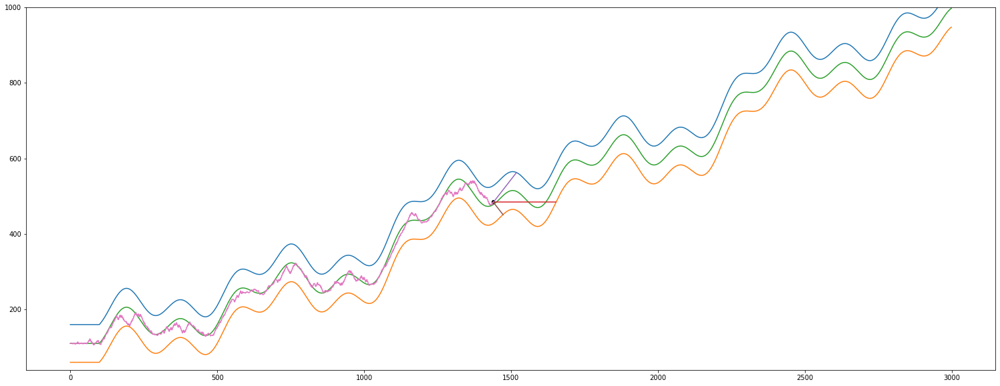

Streaming output truncated to the last 5000 lines.
------------------------------ IF i % 3 == 0 ------------------------------
=================== TAKE ACTION ===================
-------- ennyivel módosítom self.y értékét --------
self.y régi értéke =  505.0
Sensor center =  188
Sensor from left wall =  53
Sensor from right wall =  45
most távolsagra van a felső faltól =  51.64841414523676
most távolsagra van az alsó faltól =  48.35158585476324
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1479
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -1.6484141452367567
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -1.6484141452367567
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  1480
			 len(self.sensor_left)   =  14

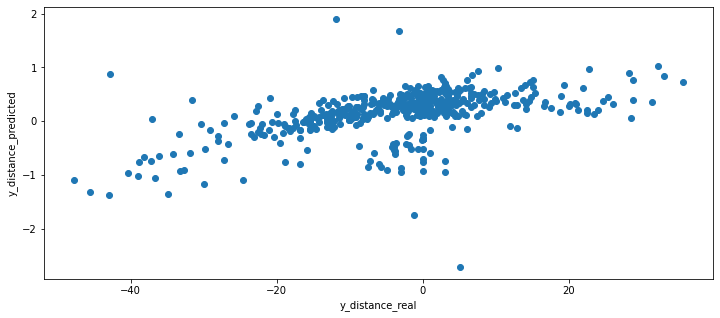

(1505, 1)
(1505, 1)


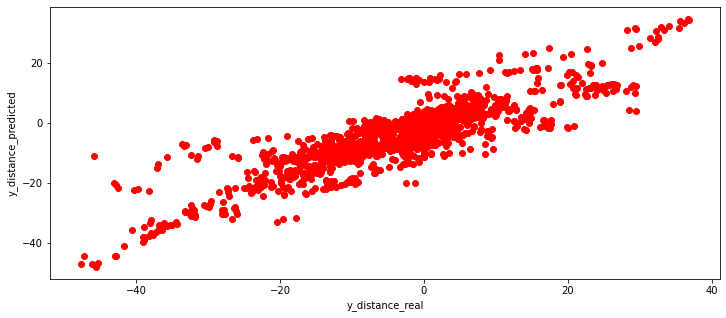

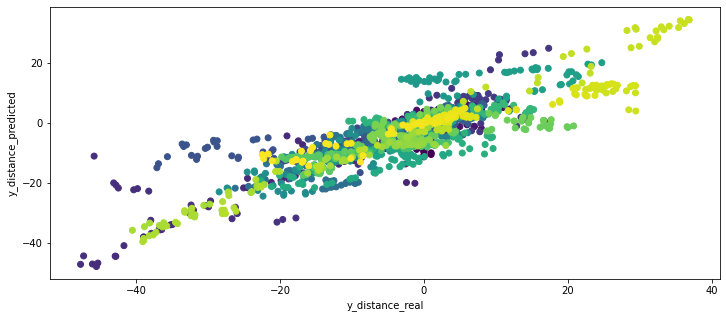

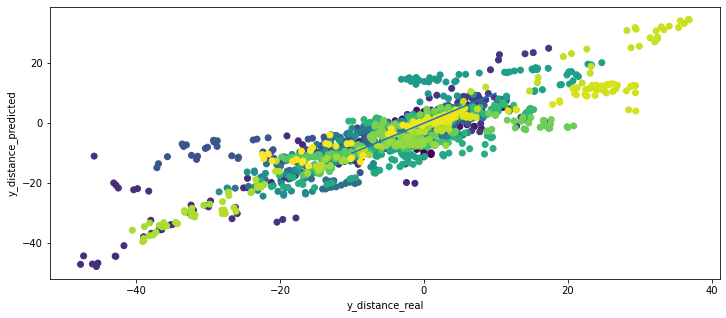

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
494.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  156
Sensor from left wall =  47
Sensor from right wall =  72
most távolsagra van a felső faltól =  71.12345135401961
most távolsagra van az alsó faltól =  28.876548645980336
ccc

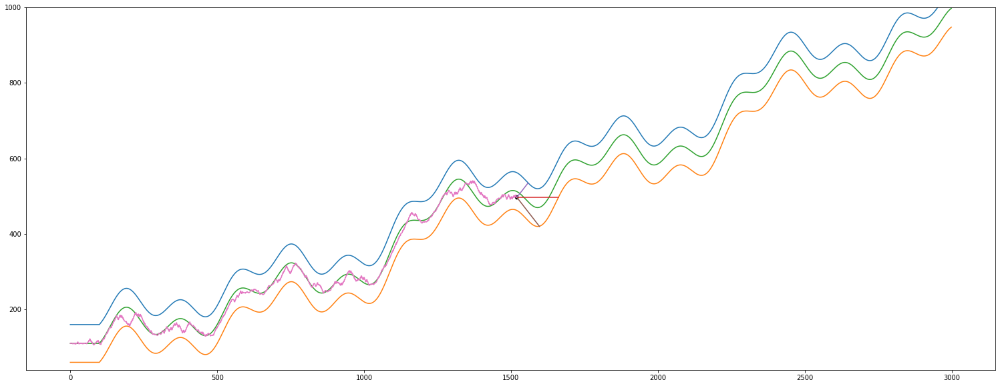

Streaming output truncated to the last 5000 lines.
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  72
Sensor from left wall =  166
Sensor from right wall =  42
most távolsagra van a felső faltól =  48.04007255318652
most távolsagra van az alsó faltól =  51.95992744681354
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1577
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  1.9599274468134809
KKKKKKKKKKKKKKKKKKKKKKKKKK

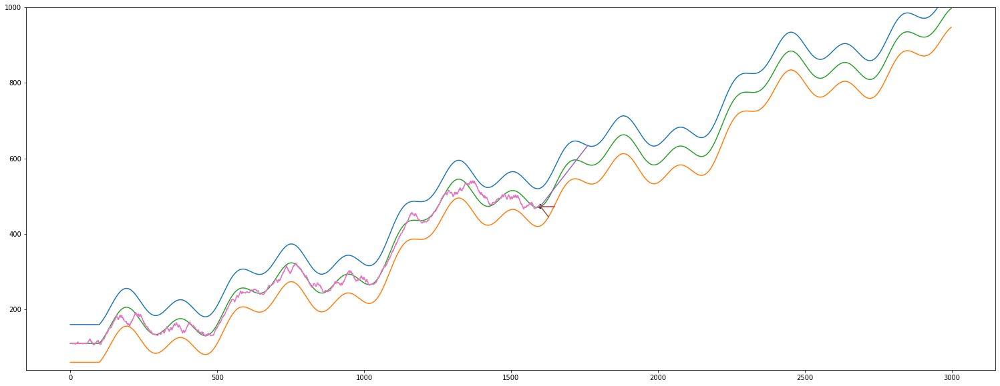

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  1600
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[162  48  29]]
actual predicted =  [0.16522968]
actual self.y_distance[-1] =  1.5029412033405833
len(self.y_distance_real)      =  527
len(self.y_distance_predicted) =  527


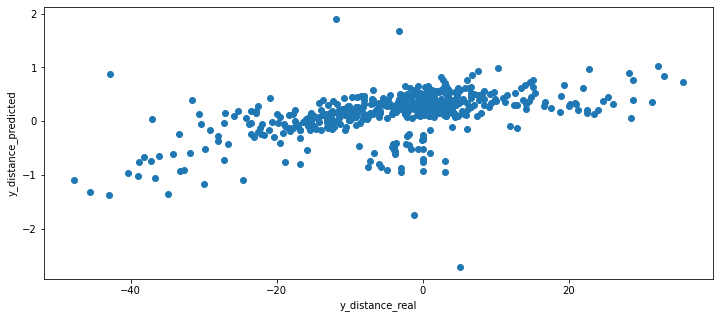

(1601, 1)
(1601, 1)


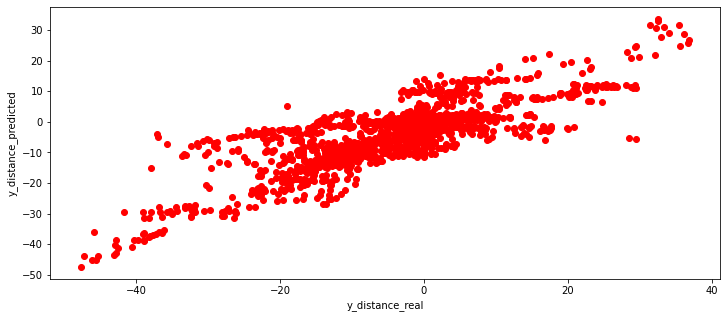

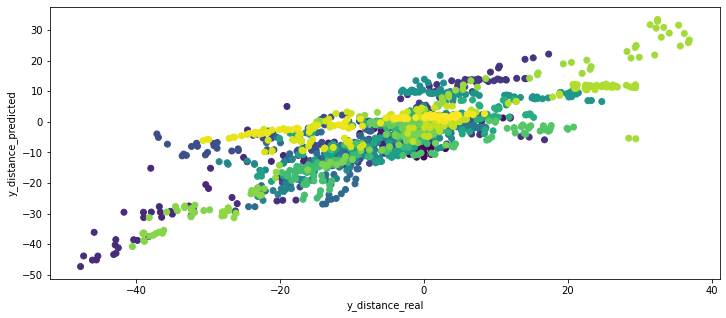

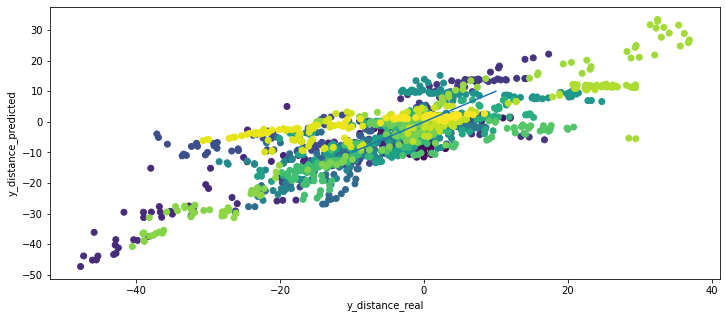

Streaming output truncated to the last 5000 lines.
		 regression_left.coef_   =  [[ 0.99002359 -1.2633118 ]]
		 regression_center.coef_ =  [[ 0.98640294 -0.72480297]]
		 regression_right.coef_  =  [[0.99843464 0.90517704]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[104.05560615  40.38252342  16.34798459]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-2.16147905]]
		 predicted_position neural net model scaled =  [-0.05494261]
		 predicted_position neural net model inverz =  [[-7.74241771]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.38766179 -0.85701032 -0.8

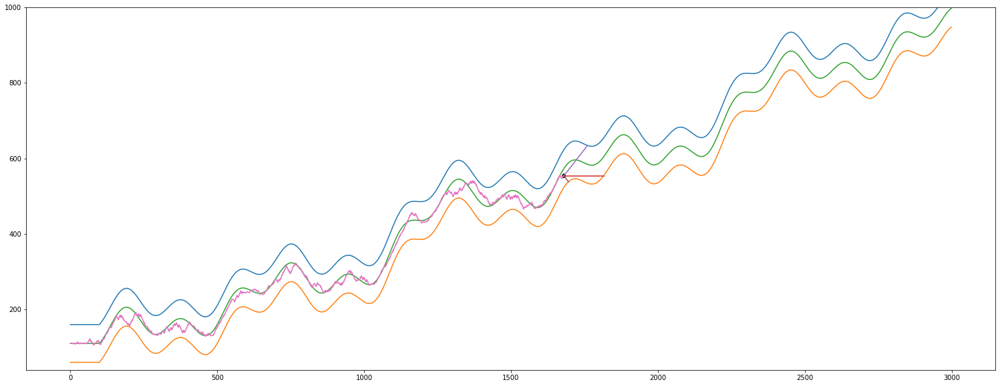

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  1680
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (1681, 3)
y.shape =  (1681, 1)
i       =  1680
---------------------
X.max =  396
X.min =  7
X[:,0].max =  324
X[:,0].min =  7
X[:,1].max =  396
X[:,1].min =  13
X[:,2].max =  124
X[:,2].min =  7
y.max =  36.884645166790506
y.min =  -47.721024506312574
---------------------
X_scaled.shape =  (1681, 3)
y_scaled.shape =  (1681, 1)
X_scaled.max =  1.0
X_scaled.min =  -1.0
X_scaled[:,0].max =  0.9999999999999998
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  1.0
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0
X_scaled[:,2].min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  1680
  Ha már van elég before after adatunk
# 3. Tanulás itt ker

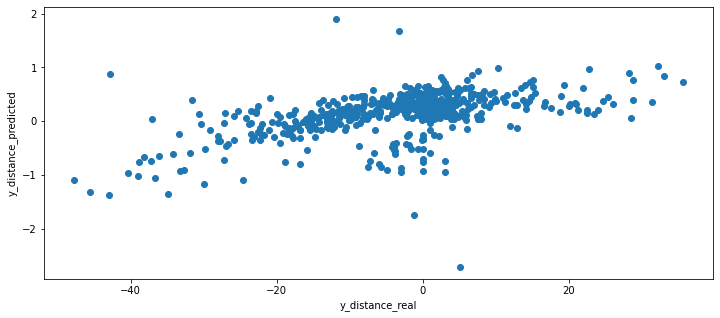

(1697, 1)
(1697, 1)


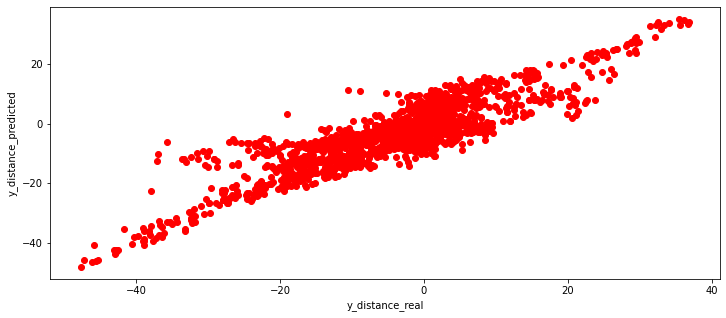

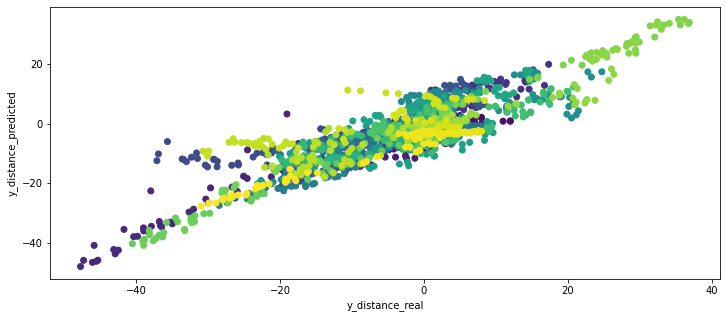

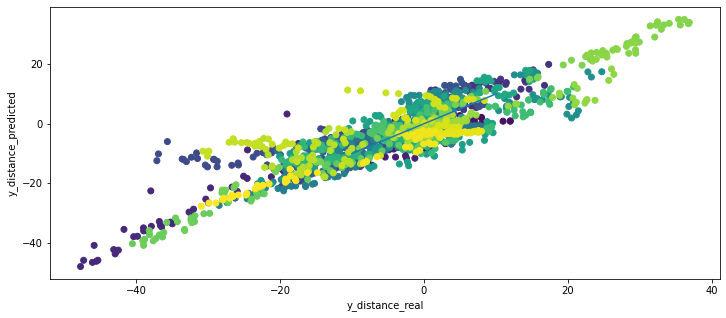

Streaming output truncated to the last 5000 lines.
			 -------------- Append End --------------
------------------------------ IF i % 3 == 2 ------------------------------
# i =  1736
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down second
Sensor center =  123
Sensor from left wall =  32
Sensor from right wall =  63
most távolsagra van a felső faltól =  42.033072994043664
most távolsagra van az alsó faltól =  57.966927005956336
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1736
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  7.966927005956336
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  7.966927005956336
			 ---------------- Teszt ----------------
			 len(self.y_distan

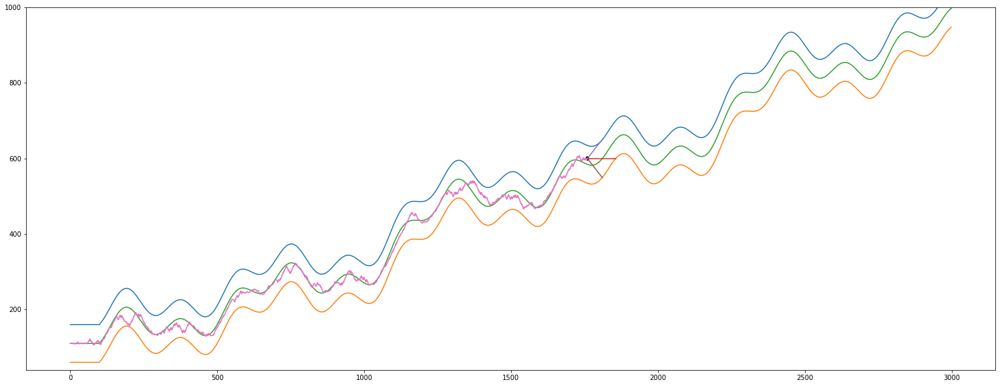

Streaming output truncated to the last 5000 lines.
			 len(self.y_distance)    =  1768
			 len(self.sensor_left)   =  1768
			 len(self.sensor_center) =  1768
			 len(self.sensor_right)  =  1768
			 self.x                  =  1768
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  1769
			 len(self.sensor_left)   =  1769
			 len(self.sensor_center) =  1769
			 len(self.sensor_right)  =  1769
			 self.x                  =  1768
			 -------------- Append End --------------
------------------------------ IF i % 3 == 1 ------------------------------
# i =  1768
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 42 100  51]]
actual predicted =  [0.09689517]
actual self.y_distance[-1] =  24.331103189047894
len(self.y_distance_real)      =  583
len(self.y_distance_predicted) =  583
# A run ciklus vége --------------

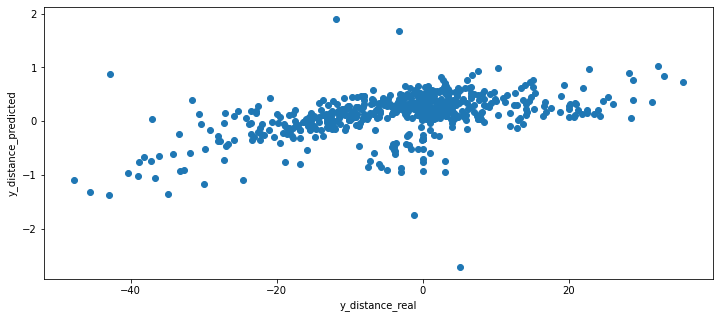

(1793, 1)
(1793, 1)


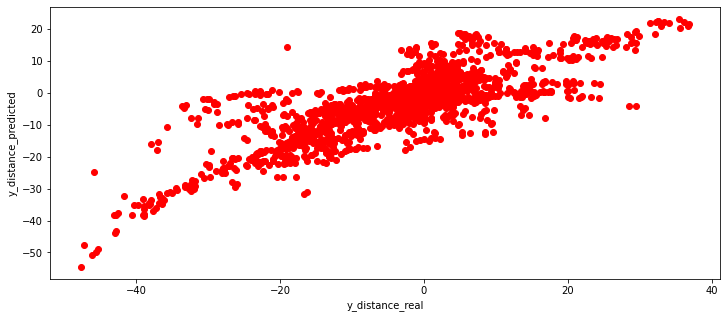

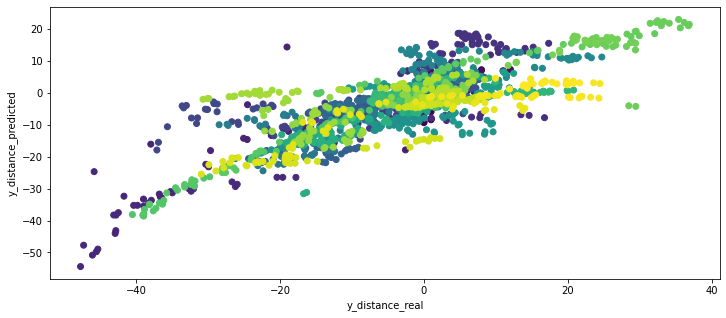

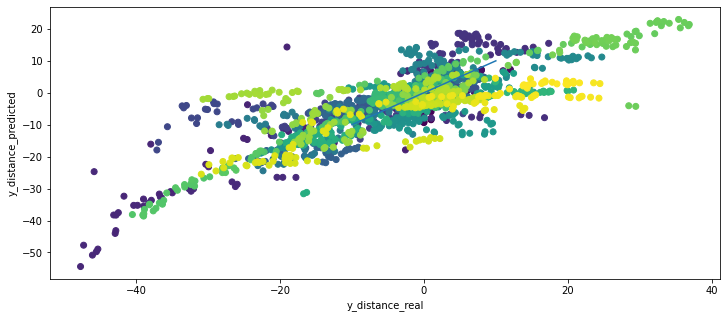

Streaming output truncated to the last 5000 lines.
 [-4.  2. -9. -1.]
 [-1.  0. -2. -1.]]
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------------------------------------------------------------
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_left.coef_ =  [[ 0.98992401 -1.29663273]]
		 regression_left.intercept_ =  0.0
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98719216 -0.49642609]]
		 regression_center.intercept_ 0.0
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[0.99865674 0.88414173]]
		 regression_right.intercept_ =  0.0
	 # Az egyes lépések várható kimeneteinek kiszámolása ----

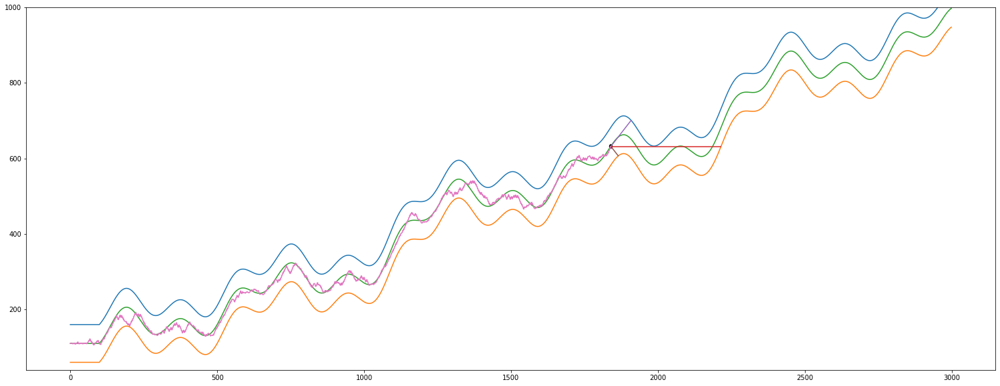

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_right)  =  1866
			 self.x                  =  1865
			 -------------- Append End --------------
------------------------------ IF i % 3 == 2 ------------------------------
# i =  1865
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> down first
Sensor center =  84
Sensor from left wall =  45
Sensor from right wall =  125
most távolsagra van a felső faltól =  50.68146229406227
most távolsagra van az alsó faltól =  49.31853770593773
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  1865
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -0.6814622940622712
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -0.681462294

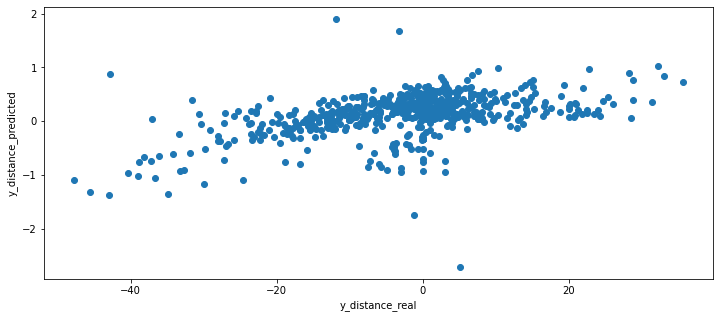

(1889, 1)
(1889, 1)


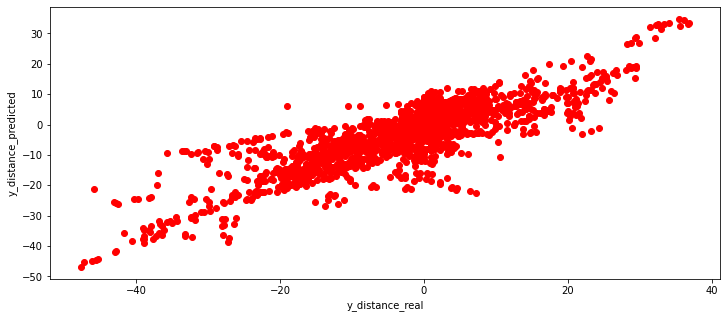

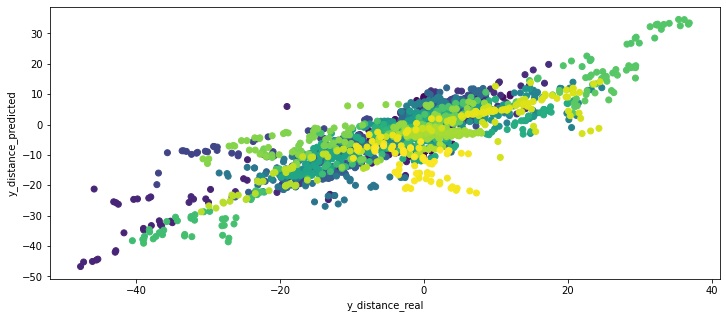

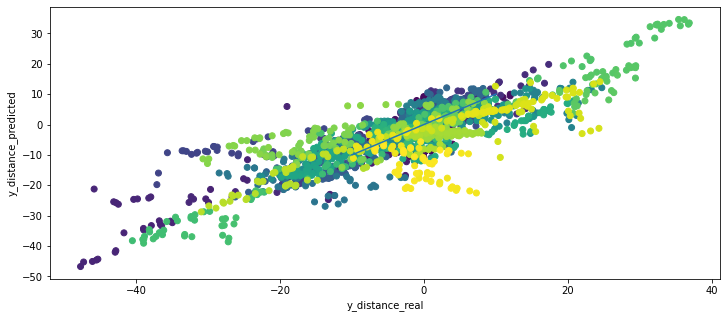

Streaming output truncated to the last 5000 lines.
X_scaled[:,1].max =  1.0
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0
X_scaled[:,2].min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  1896
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
delta_array = 
 [[ 0.  0.  0.  0.]
 [ 1. -1.  1.  1.]
 [ 0.  0.  0.  0.]
 ...
 [-1.  1.  0. -1.]
 [ 1.  0.  0.  0.]
 [ 1. -1. -1.  1.]]
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------------------------------------------------------------
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_left.coef_ =  [[ 0.99005875 -1.26018536]]
		 regression_left.intercept

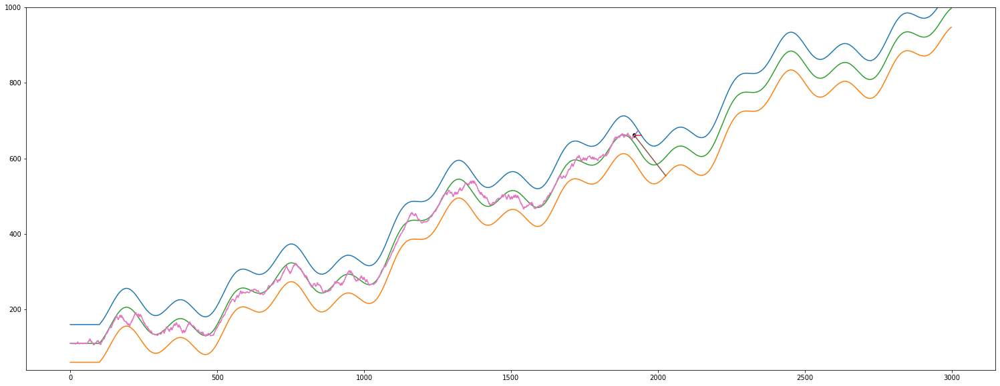

Streaming output truncated to the last 5000 lines.
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[  4.75089449 247.58113026  75.47510038]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-3.21266842]]
		 predicted_position neural net model scaled =  [0.89369501]
		 predicted_position neural net model inverz =  [[34.6014143]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-1.00785601  0.22899288  0.13181984]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_position_scaled =  [0.89369501]
		 --------------------------

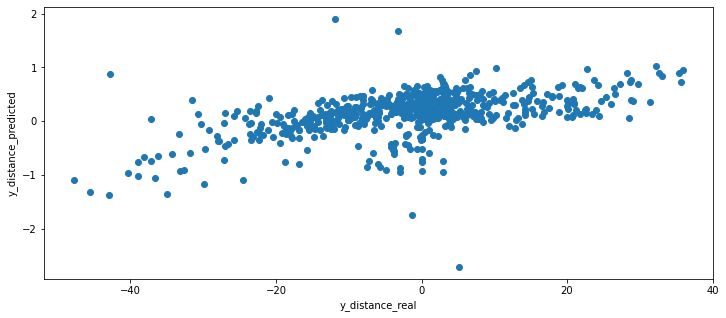

(1985, 1)
(1985, 1)


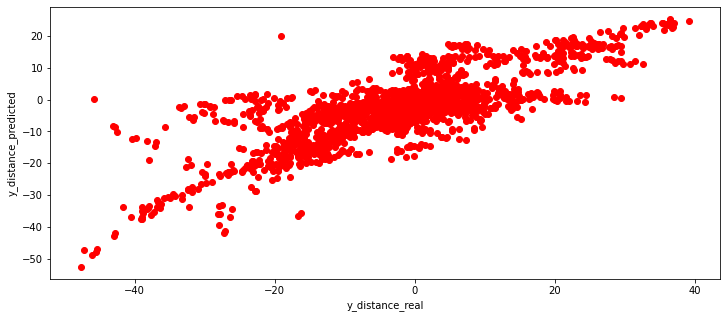

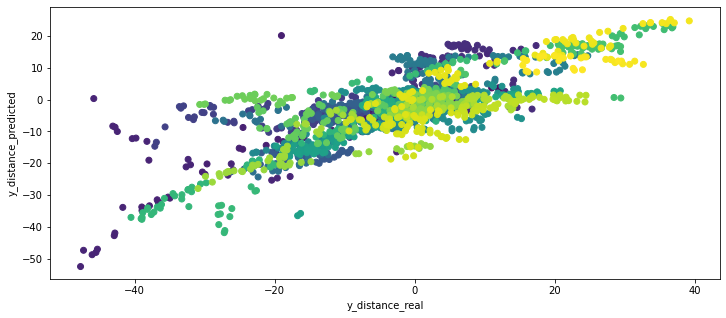

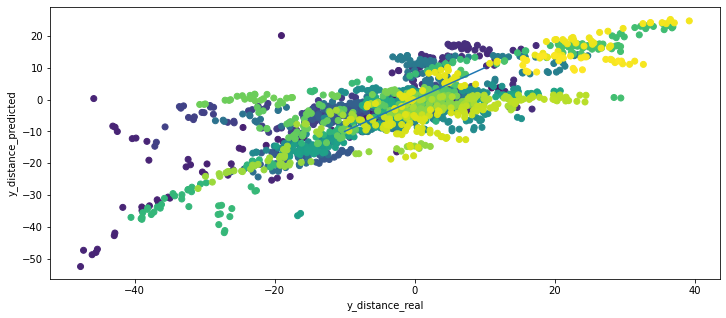

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
612.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  221
Sensor from left wall =  46
Sensor from right wall =  51
most távolsagra van a felső faltól =  20.855706451620108
most távolsagra van az alsó faltól =  79.14429354837989
ccc

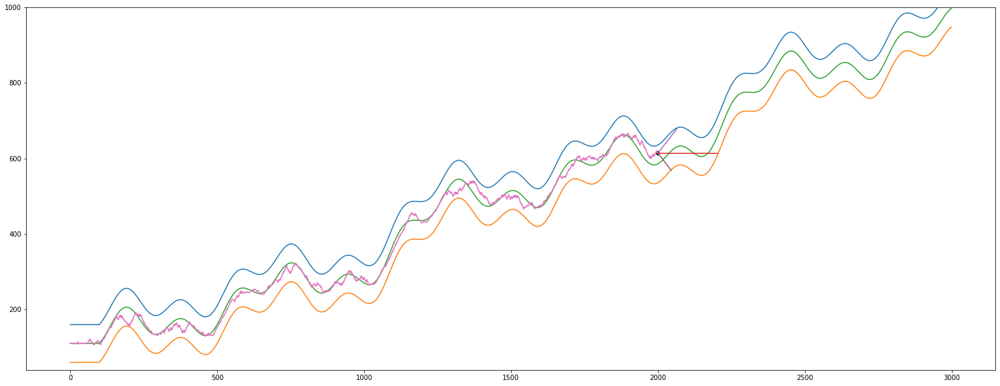

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_center) =  2058
			 len(self.sensor_right)  =  2058
			 self.x                  =  2057
			 -------------- Teszt End --------------
self.y =  600.0
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
600.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_mesterseges_mozgatas      =  1
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
S

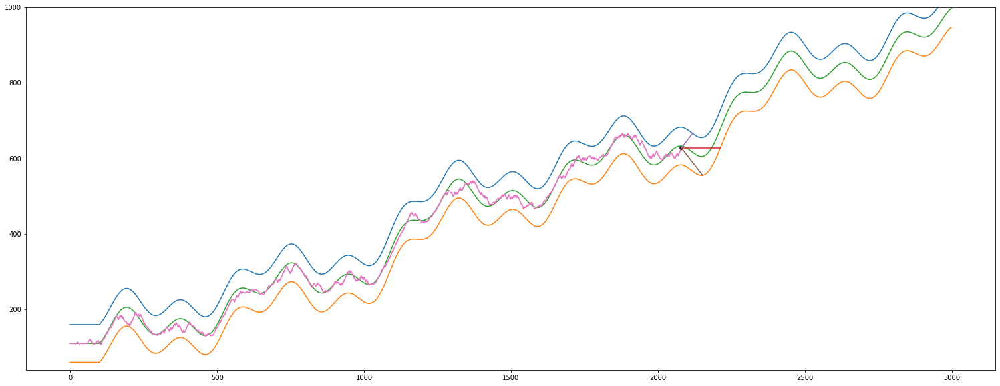

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  2080
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 39 134  74]]
actual predicted =  [-0.06232202]
actual self.y_distance[-1] =  -4.865885873920206
len(self.y_distance_real)      =  687
len(self.y_distance_predicted) =  687


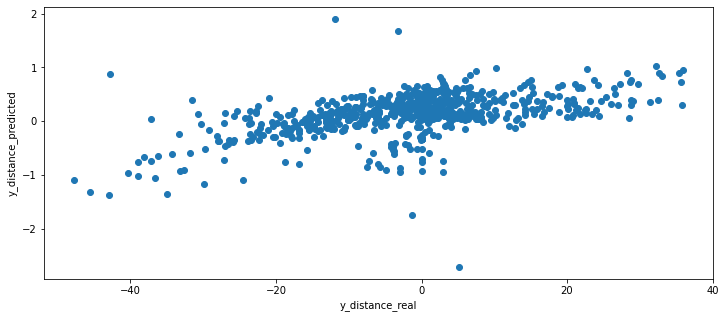

(2081, 1)
(2081, 1)


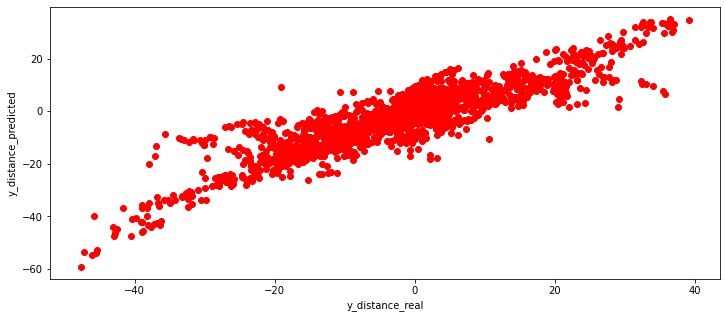

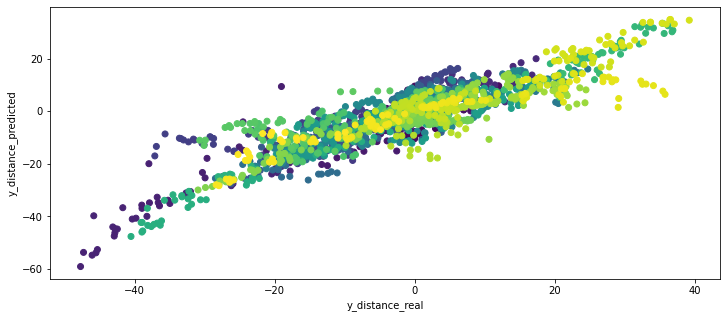

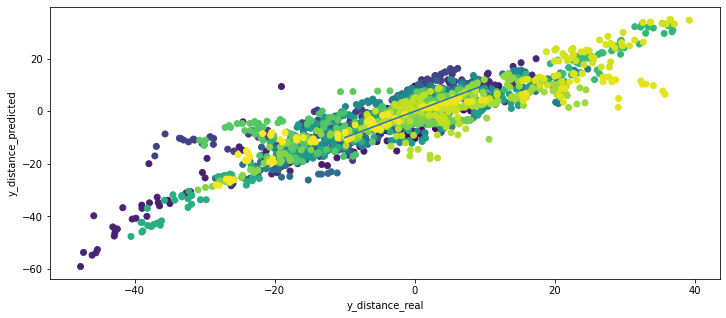

Streaming output truncated to the last 5000 lines.
		 regression_left.intercept_ =  0.0
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98398023 -0.3229709 ]]
		 regression_center.intercept_ 0.0
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[1.00018285 0.8860447 ]]
		 regression_right.intercept_ =  0.0
	 # Az egyes lépések várható kimeneteinek kiszámolása ----------------------------------------------
		 # Ennyivel mozdulna el egy szenzor adat 1 egység változással ha 1 lenne a before értéke
proba_X_metrika   =  [[1 1]]
-------- 1 y up ->  left   =  [[-0.33781265]]
-------- 1 y up ->  center =  [[0.66100933]]
-------- 1 y up ->  right  =  [[1.88622755]]




		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -5
		 ------------------------ a 

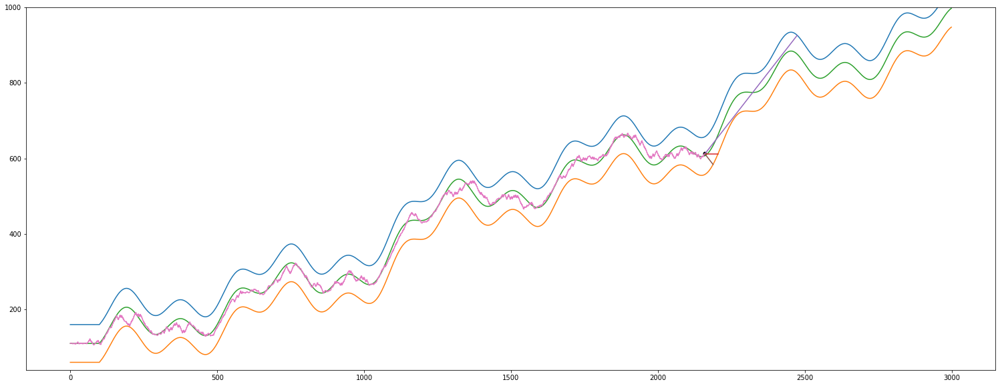

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2160
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2161, 3)
y.shape =  (2161, 1)
i       =  2160
---------------------
X.max =  396
X.min =  6
X[:,0].max =  329
X[:,0].min =  6
X[:,1].max =  396
X[:,1].min =  11
X[:,2].max =  128
X[:,2].min =  7
y.max =  39.22268970305515
y.min =  -47.721024506312574
---------------------
X_scaled.shape =  (2161, 3)
y_scaled.shape =  (2161, 1)
X_scaled.max =  1.0
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  0.9999999999999998
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0
X_scaled[:,2].min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  2160
  Ha már van elég before after adatunk
# 3. Tanulás itt kerü

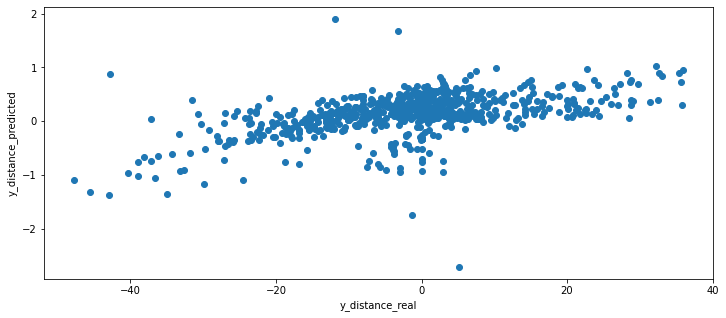

(2177, 1)
(2177, 1)


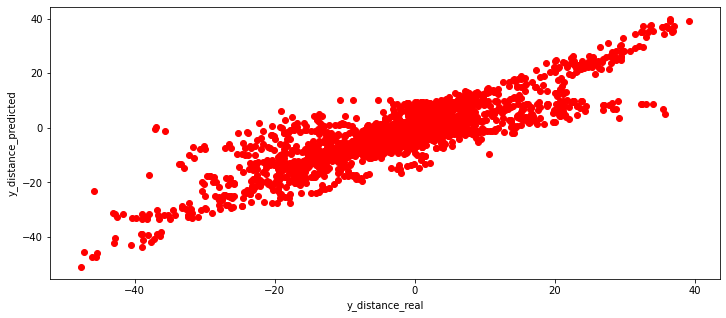

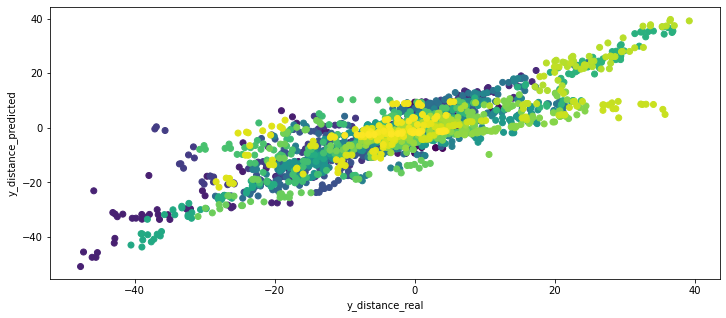

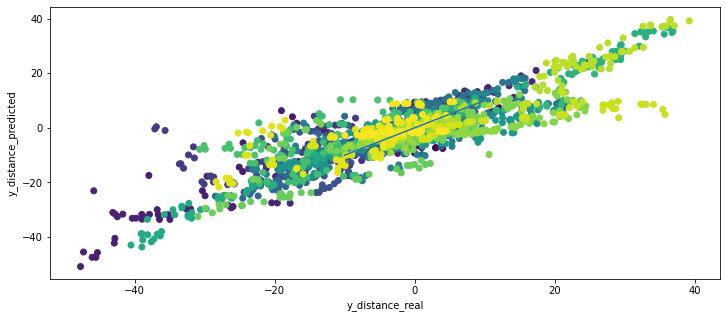

Streaming output truncated to the last 5000 lines.
		 adott j-re -4 kiszámoltuk az előrejelzést de még nem hoztunk döntést -------------------------------------------------
		 --------------------------------------------------------------------------------------------------------------------------------------


		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -3
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[261  -3]]
		 _X_center =  [[15 -3]]
		 _X_right  =  [[10 -3]]
		 predicted_left   =  [[263.60036246]]
		 predicted_center =  [[15.6115102]]
		 predicted_right  =  [[7.41039688]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99499867 -1.30190318]]
		 regression_center.coef_ =  [[ 0.98399208 -0.28387632]]
		 regression_right.coef_  =  [[1.00008921 0.86349841]]
		 regression_left.interce

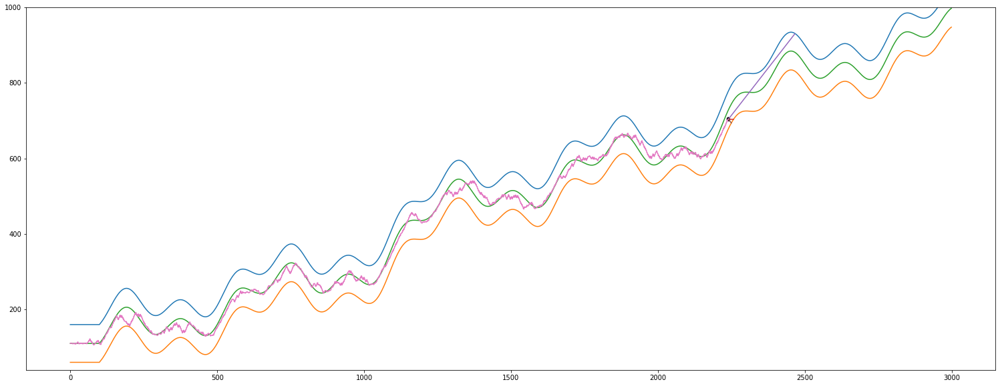

Streaming output truncated to the last 5000 lines.
		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -5
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[214  -5]]
		 _X_center =  [[27 -5]]
		 _X_right  =  [[12 -5]]
		 predicted_left   =  [[219.50399571]]
		 predicted_center =  [[27.86631145]]
		 predicted_right  =  [[7.73271111]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99562458 -1.28806714]]
		 regression_center.coef_ =  [[ 0.98399465 -0.25969116]]
		 regression_right.coef_  =  [[1.00002644 0.85352123]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[219.50399571  27.86631145   7.73271111]]
		 ---------------Brutáli

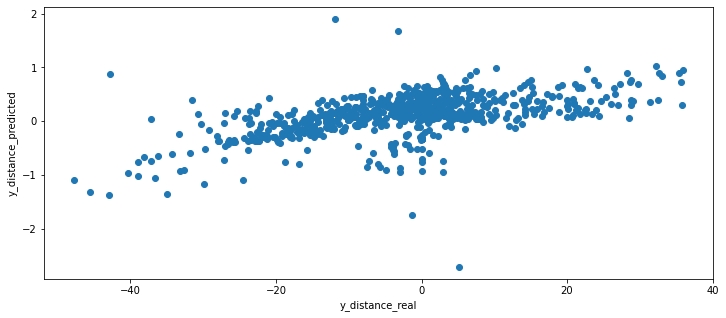

(2273, 1)
(2273, 1)


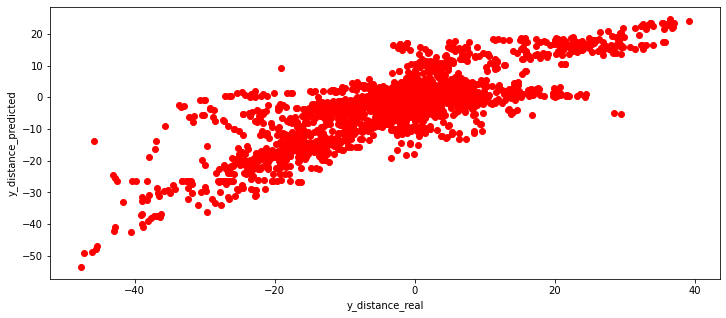

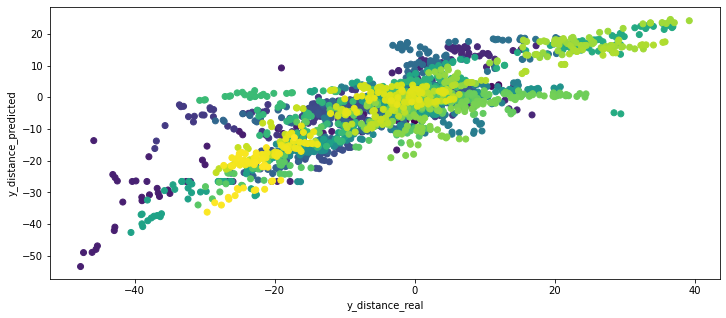

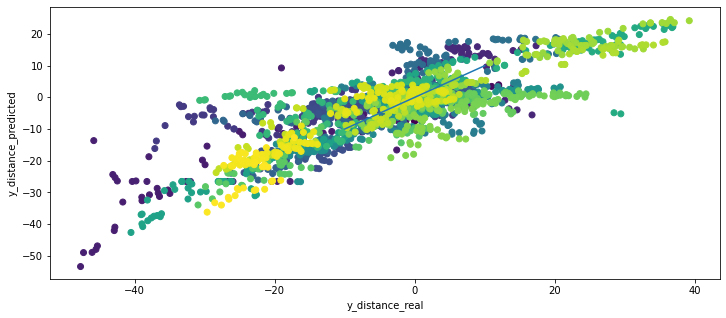

Streaming output truncated to the last 5000 lines.
most távolsagra van az alsó faltól =  28.311986192054405
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  2298
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -21.688013807945595
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -21.688013807945595
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  2298
			 len(self.sensor_left)   =  2298
			 len(self.sensor_center) =  2298
			 len(self.sensor_right)  =  2298
			 self.x                  =  2298
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  2299
			 len(self.sensor_left)   =  2299
			 len(self.sensor_center) =  2299
			 len(self.sensor_right)  =  22

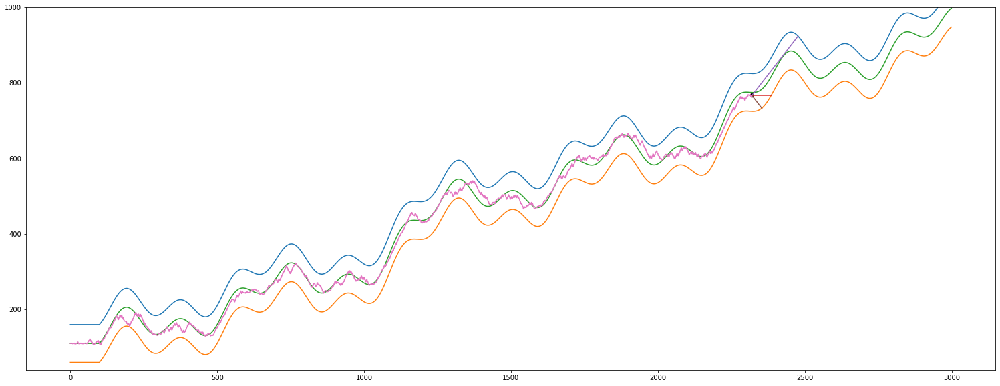

Streaming output truncated to the last 5000 lines.
---------------------
X.max =  396
X.min =  6
X[:,0].max =  329
X[:,0].min =  6
X[:,1].max =  396
X[:,1].min =  11
X[:,2].max =  128
X[:,2].min =  7
y.max =  39.22268970305515
y.min =  -47.721024506312574
---------------------
X_scaled.shape =  (2347, 3)
y_scaled.shape =  (2347, 1)
X_scaled.max =  1.0
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  0.9999999999999998
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0
X_scaled[:,2].min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  2346
  Ha már van elég before after adatunk
# 3. Tanulás itt kerül kiszámításra a lineáris regresszió minden egyes metrikára
delta_array = 
 [[ 0.  0.  0.  0.]
 [ 1. -1.  1.  1.]
 [ 0.  0.  0.  0.]
 ...
 [ 1.  0.  1.  1.]
 [ 1.  0.  0.  1.]
 [-1.  0.  0. -1.]]
# Linear Regression Learning ---------

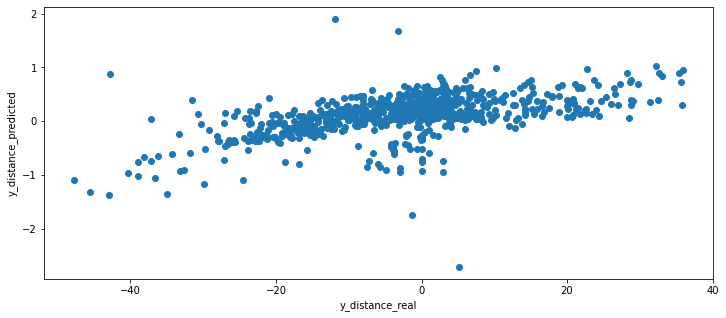

(2369, 1)
(2369, 1)


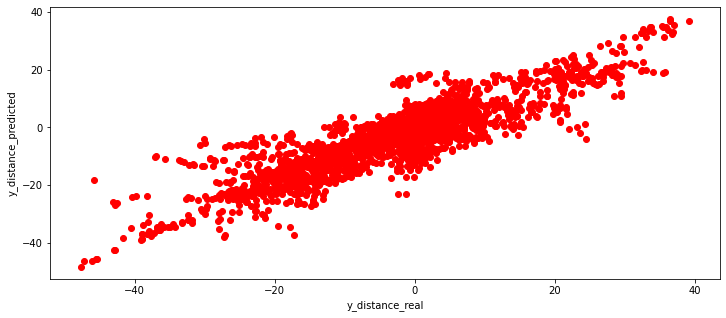

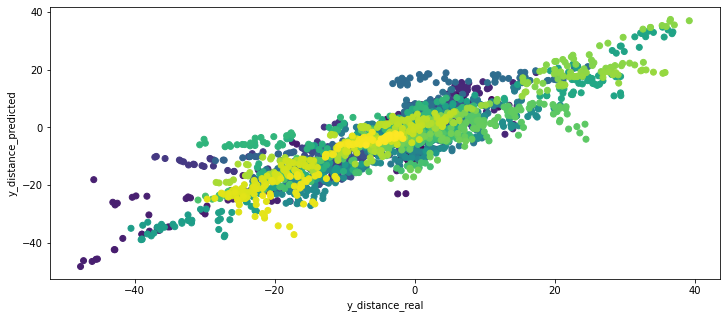

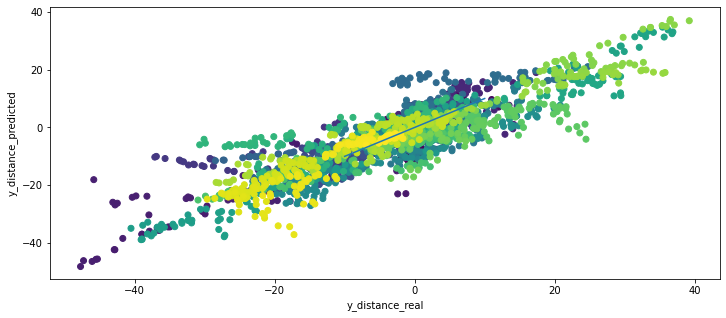

Streaming output truncated to the last 5000 lines.

		 minden j-re kiszámolom a regressziót és be is helyetessítjük a kapott értékekekt a modellba
		 j =  -2
		 ------------------------ a regresszió bemenetei az éppen aktuális értékek -------------------
		 _X_left   =  [[114  -2]]
		 _X_center =  [[33 -2]]
		 _X_right  =  [[19 -2]]
		 predicted_left   =  [[116.2319641]]
		 predicted_center =  [[32.84210182]]
		 predicted_right  =  [[17.30313563]]
		 --------------------- a regression úgy tűnik, hogy jó és pontos ----------------------
		 regression_left.coef_   =  [[ 0.99450908 -1.42896428]]
		 regression_center.coef_ =  [[ 0.98427986 -0.18043319]]
		 regression_right.coef_  =  [[0.99993098 0.84777646]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[116.2319641   32.84210182  17.30313563]]
		 ---------------Brutál

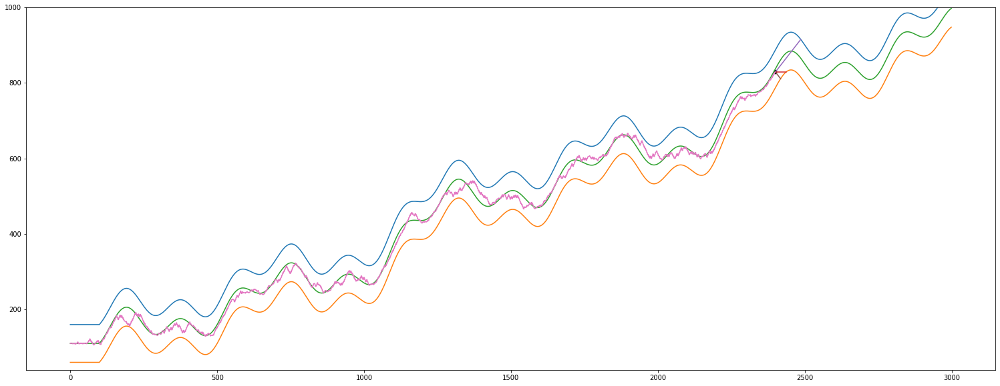

Streaming output truncated to the last 5000 lines.
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  0.33396094703221024
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  0.33396094703221024
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  2442
			 len(self.sensor_left)   =  2442
			 len(self.sensor_center) =  2442
			 len(self.sensor_right)  =  2442
			 self.x                  =  2441
			 -------------- Teszt End --------------
self.y =  882.0
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
882.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  0
# 			 _summary_m

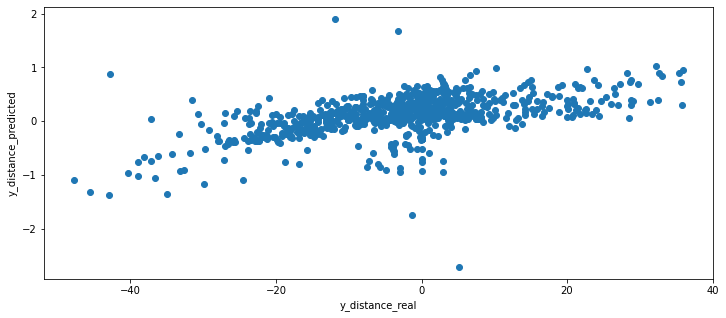

(2465, 1)
(2465, 1)


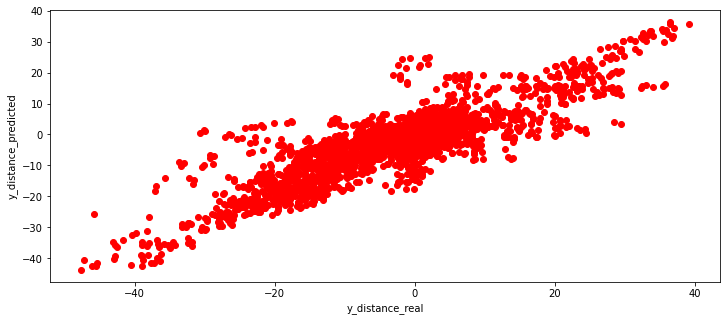

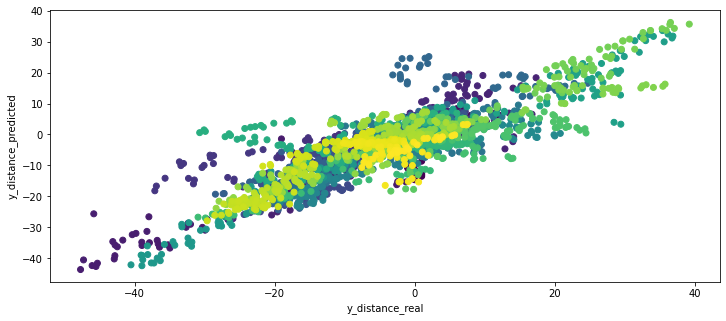

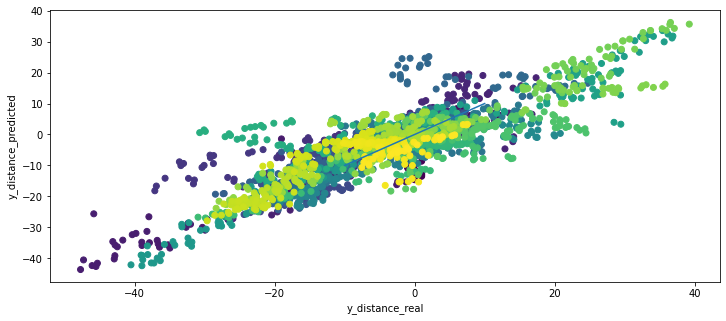

 --- plot predcition --- 
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
888.0
# 		 ----------------- Summary -----------------
# 			 _summary_mlp_fit_was_taken         =  0
# 			 _summary_mlp_prediction_was_taken  =  1
# 			 _summary_mesterseges_mozgatas      =  0
# 			 _summary_action_were_taken         =  0
# A run ciklus vége ++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
# A run ciklus eleje -----------------------------------------------------------------------------------------------------------------------------------------
Sensor center =  47
Sensor from left wall =  25
Sensor from right wall =  116
most távolsagra van a felső faltól =  43.85414050193856
most távolsagra van az alsó faltól =  56.14585949806144
cccc

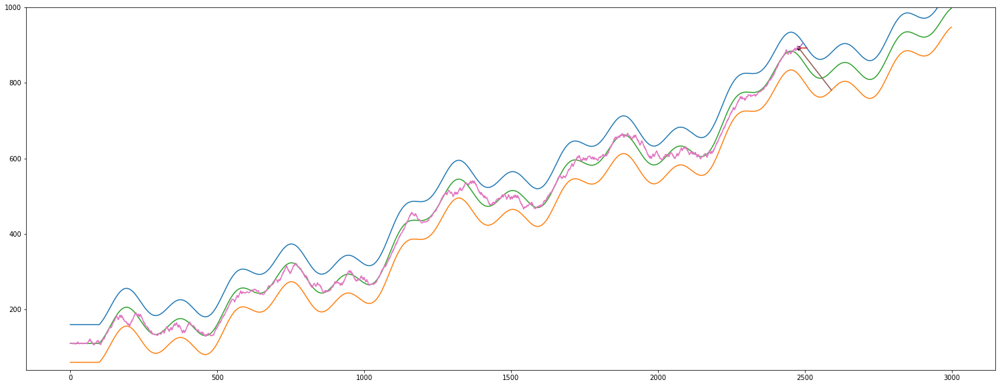

Streaming output truncated to the last 5000 lines.
most távolsagra van a felső faltól =  13.619102177589639
most távolsagra van az alsó faltól =  113.61910217758964
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  2535
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  63.61910217758964
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  63.61910217758964
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  2536
			 len(self.sensor_left)   =  2536
			 len(self.sensor_center) =  2536
			 len(self.sensor_right)  =  2536
			 self.x                  =  2535
			 -------------- Teszt End --------------
self.y új értéke   =  881.0
action             =  5
----------------- módosítás vége -----------------
# A run ciklus vége ----------

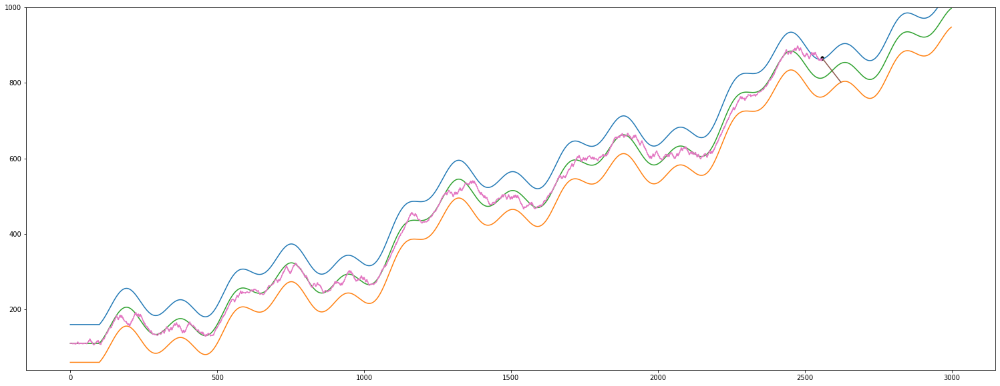

 --- plot --- 
------------------------------ IF i % 3 == 1 ------------------------------
# i =  2560
# 2. az 1. pontban megtanult modell alapján teszünk egy becslést - tulajdonképpen ezzel mérem az 1. modell jóságát, ez a lépés ezt szolgálja
actual _X_test =  [[ 1  1 64]]
actual predicted =  [0.64882256]
actual self.y_distance[-1] =  51.75049256363434
len(self.y_distance_real)      =  847
len(self.y_distance_predicted) =  847


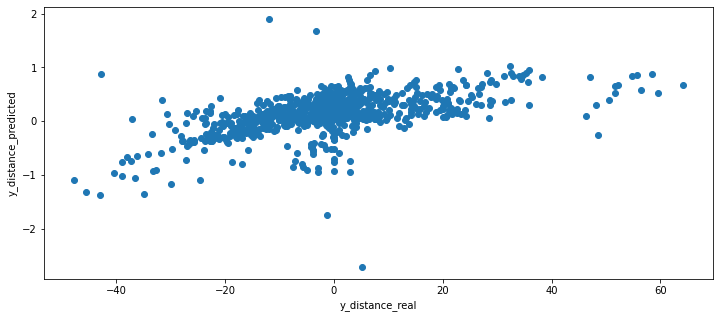

(2561, 1)
(2561, 1)


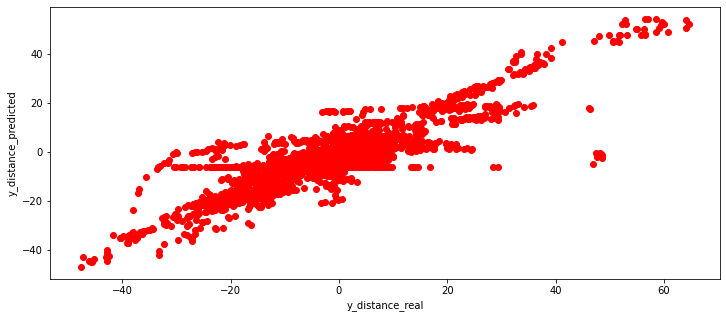

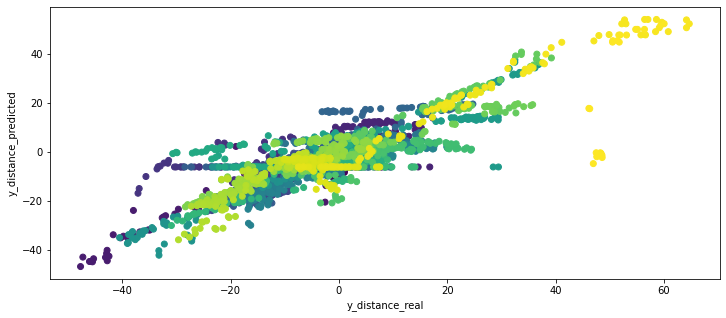

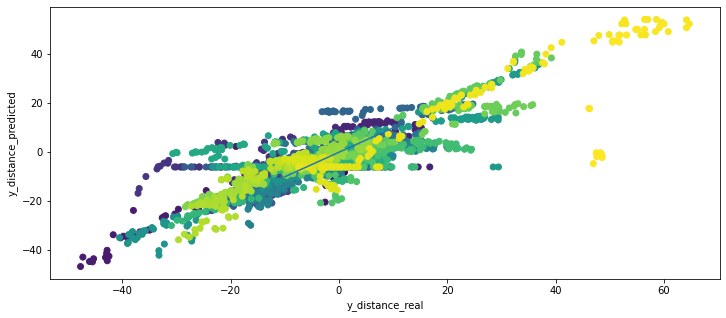

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_left)   =  2616
			 len(self.sensor_center) =  2616
			 len(self.sensor_right)  =  2616
			 self.x                  =  2615
			 -------------- Append End --------------
------------------------------ IF i % 3 == 2 ------------------------------
# i =  2615
# 3. véletlenszerűen változtatok az autó pozicióján -> ebből állnak elő a before after adatok
artificial move -> up second
Sensor center =  81
Sensor from left wall =  33
Sensor from right wall =  112
most távolsagra van a felső faltól =  27.978684819232058
most távolsagra van az alsó faltól =  72.02131518076794
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  2615
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  22.021315180767942
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni,

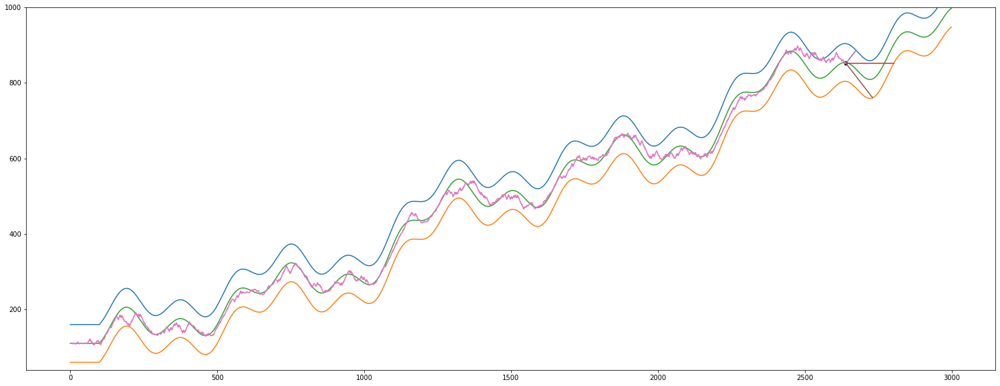

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2640
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2641, 3)
y.shape =  (2641, 1)
i       =  2640
---------------------
X.max =  396
X.min =  1
X[:,0].max =  329
X[:,0].min =  1
X[:,1].max =  396
X[:,1].min =  1
X[:,2].max =  128
X[:,2].min =  7
y.max =  64.68009167667151
y.min =  -47.721024506312574
---------------------
X_scaled.shape =  (2641, 3)
y_scaled.shape =  (2641, 1)
X_scaled.max =  1.0000000000000002
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0000000000000002
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  1.0
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0
X_scaled[:,2].min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  2640
  Ha már van elég before after adatunk
# 3. Ta

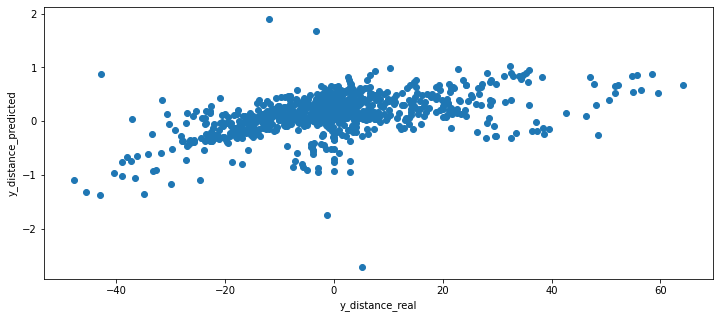

(2657, 1)
(2657, 1)


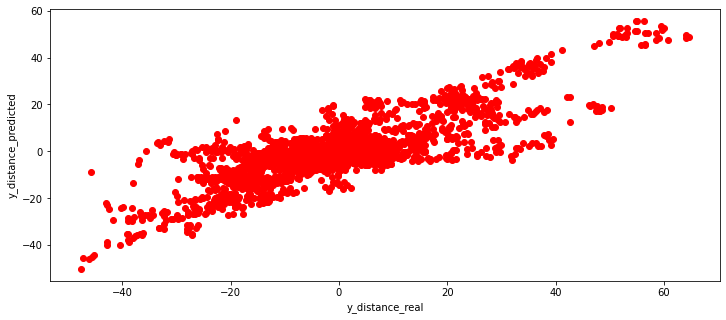

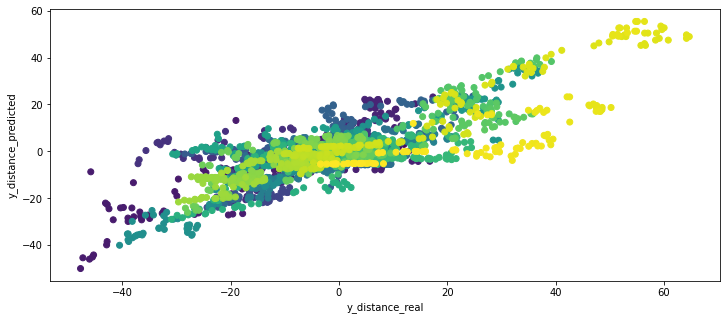

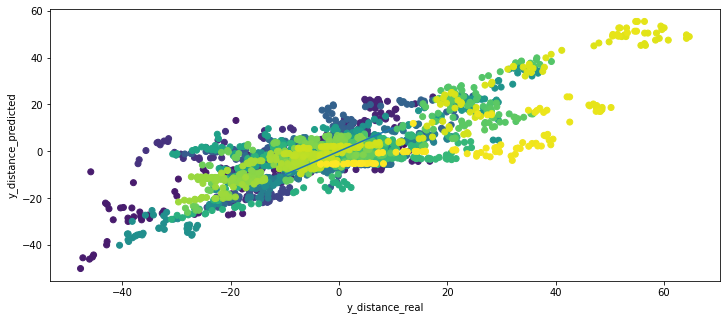

Streaming output truncated to the last 5000 lines.
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
self.x                       =  2696
cccccccccccccccccccccccccccccccccccccccccccccccccccccccccccc
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
self.vertical_distance_from_middle =  -5.357271124557428
KKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKKK
ezt fogjuk becsülni, ez a felsőtől és alsótól vett távolságának a hányadosa =  -5.357271124557428
			 ---------------- Teszt ----------------
			 len(self.y_distance)    =  2697
			 len(self.sensor_left)   =  2697
			 len(self.sensor_center) =  2697
			 len(self.sensor_right)  =  2697
			 self.x                  =  2696
			 -------------- Teszt End --------------
self.y =  814.0
# A run ciklus vége ------------------------------------------------------------------------------------------------------------------------------------------
#   itt adom hozzás a self.y a self.y_history-hoz
#    self.y :
814.0


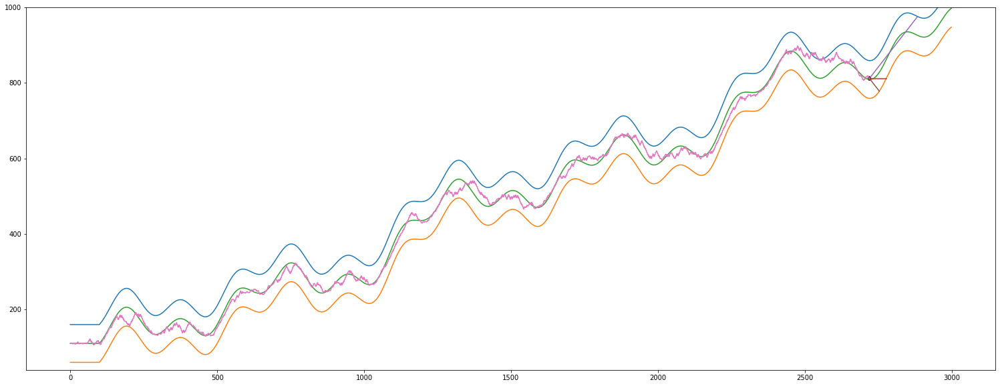

Streaming output truncated to the last 5000 lines.
			 len(self.sensor_center) =  2731
			 len(self.sensor_right)  =  2731
			 self.x                  =  2730
			 -------------- Append End --------------
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2730
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2731, 3)
y.shape =  (2731, 1)
i       =  2730
---------------------
X.max =  396
X.min =  1
X[:,0].max =  329
X[:,0].min =  1
X[:,1].max =  396
X[:,1].min =  1
X[:,2].max =  128
X[:,2].min =  7
y.max =  64.68009167667151
y.min =  -47.721024506312574
---------------------
X_scaled.shape =  (2731, 3)
y_scaled.shape =  (2731, 1)
X_scaled.max =  1.0000000000000002
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0000000000000002
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  1.0
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0
X_scaled[:,2].min =  -1.0
y_scaled.max =  1.0


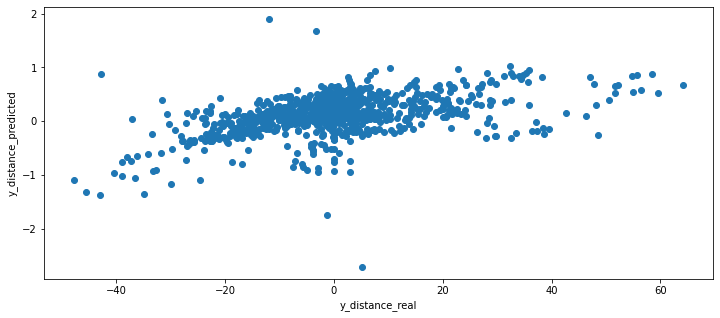

(2753, 1)
(2753, 1)


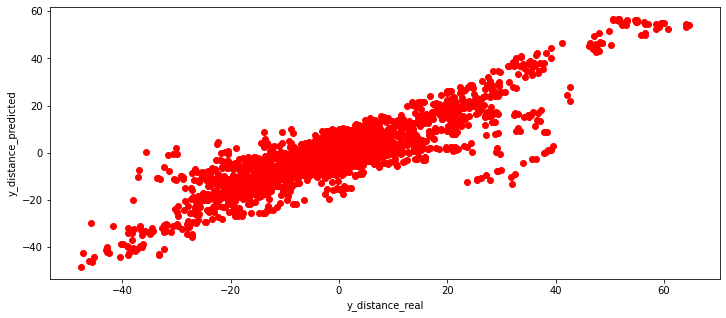

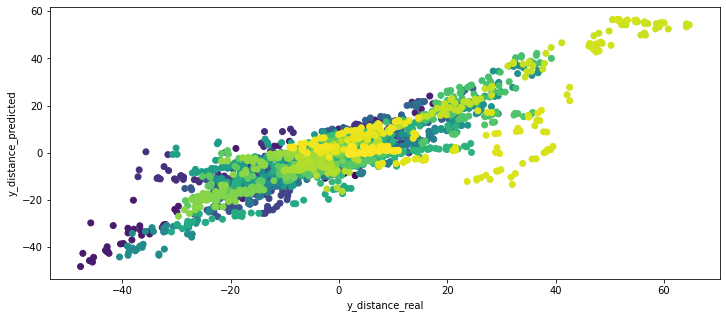

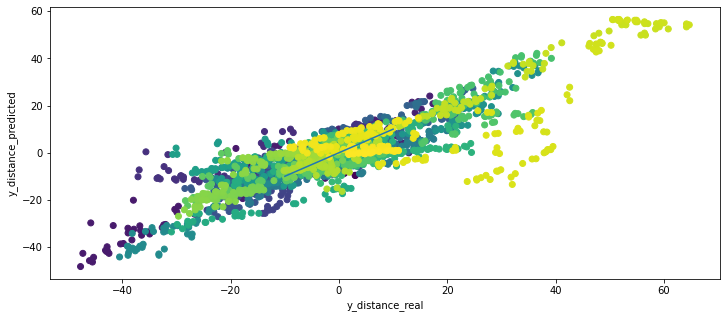

Streaming output truncated to the last 5000 lines.
		 regression_right.coef_  =  [[1.00026527 0.83359722]]
		 regression_left.intercept_   =  0.0
		 regression_center.intercept_ =  0.0
		 regression_right.intercept_  =  0.0
		 # Ez lesz a bemenete a neurális hálónak
		 -------------------------X-------------------------
		  [[122.09401311  33.86715474  13.83678877]]
		 ---------------Brutálisan hülye dolgot jelez előre ezért ellenőrizni kell, hogy mi a gond. Esetleg a bemeneti adatok?-----------------
		 predicted_position linreg model            =  [[-3.88708326]]
		 predicted_position neural net model scaled =  [-0.27392169]
		 predicted_position neural net model inverz =  [[-6.91501838]]
			 xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
			    ez az _X úgy, hogy a régi x_minmaxscaler alapján lett -1, 1 közé szorítva
			 _X_scaled =  [[-0.26162187 -0.83358403 -0.88699523]]
			    ez a predicted y úgy, hogy a régi y_minmaxscaler alapján lett -1, 1 közé szorítva
			 predicted_pos

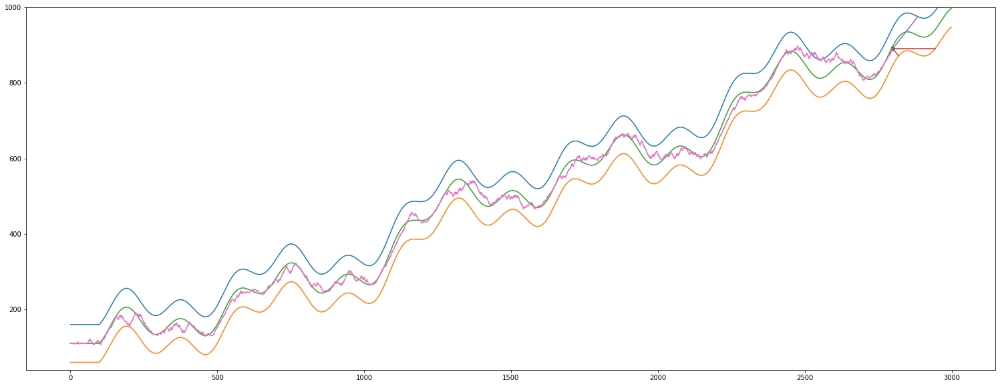

Streaming output truncated to the last 5000 lines.
 ...
 [ 1. -1.  1.  1.]
 [ 5. -4.  4.  5.]
 [-1.  1. -1. -1.]]
# Linear Regression Learning --------------------------------------------------------------------------------------
		 # Linear Regression Training Results -------------------------------------------------------------------------
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_left.coef_ =  [[ 0.99508049 -1.32258244]]
		 regression_left.intercept_ =  0.0
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_center.coef_ =  [[ 0.98222174 -0.63106823]]
		 regression_center.intercept_ 0.0
		 ------------------------------- valyon mennyire jó ennek a metrikának a becslése -----------------------------
		 regression_right.coef_ =  [[1.0002057  0.82877267]]
		 regression_right.intercept_ =  0.0
	 # Az egyes lépések várható kimen

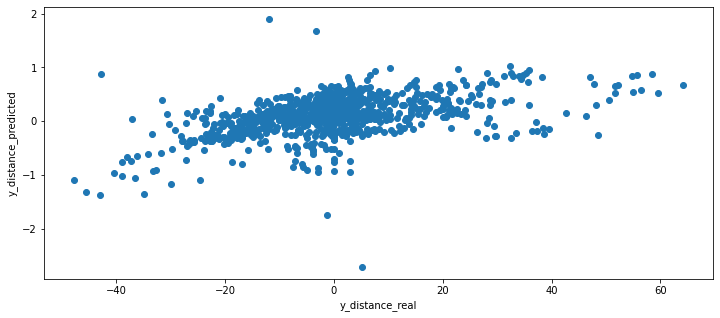

(2849, 1)
(2849, 1)


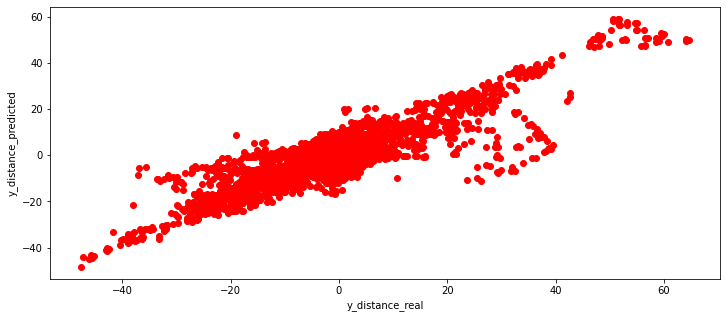

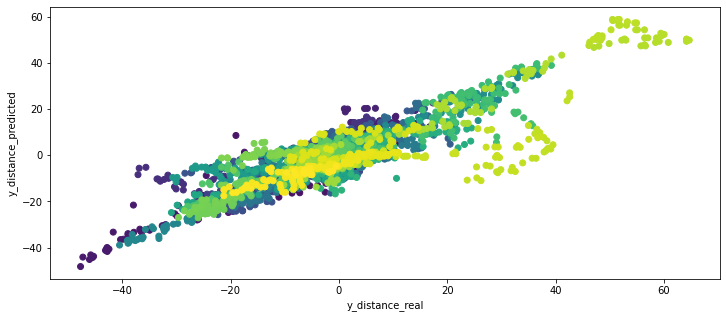

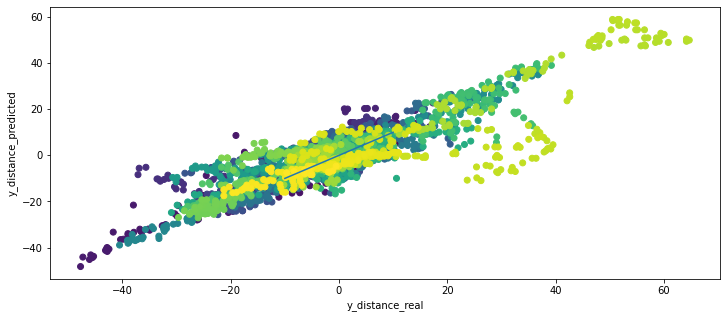

A streamkimeneten csak az utolsó 5000 sor látható.
			 len(self.sensor_center) =  2856
			 len(self.sensor_right)  =  2856
			 self.x                  =  2856
			 -------------- Teszt End --------------
			 ---------------- Append ----------------
			 len(self.y_distance)    =  2857
			 len(self.sensor_left)   =  2857
			 len(self.sensor_center) =  2857
			 len(self.sensor_right)  =  2857
			 self.x                  =  2856
			 -------------- Append End --------------
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2856
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2857, 3)
y.shape =  (2857, 1)
i       =  2856
---------------------
X.max =  396
X.min =  1
X[:,0].max =  329
X[:,0].min =  1
X[:,1].max =  396
X[:,1].min =  1
X[:,2].max =  128
X[:,2].min =  7
y.max =  64.68009167667151
y.min =  -47.721024506312574
---------------------
X_scaled.shape =  (2857, 3)
y_s

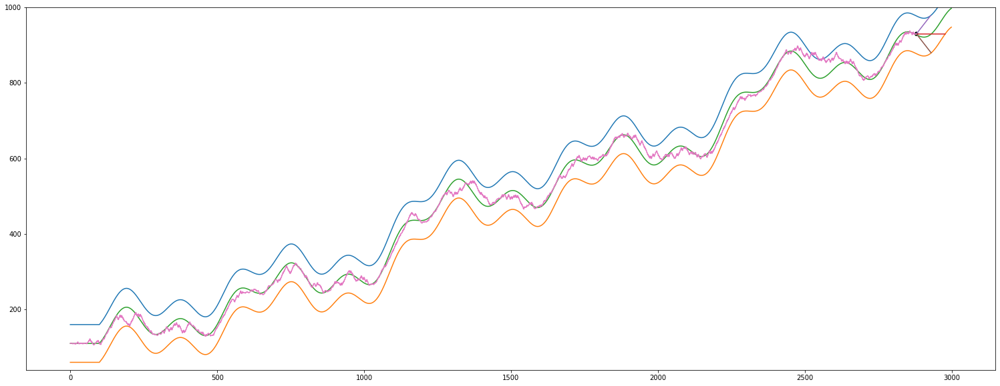

 --- plot --- 
------------------------------ IF i % 3 == 0 ------------------------------
# i =  2880
# 1. számú tanulás. Mi a kapcsolat a szenzoros adatok és aközött, hogy az út melyik részén van az autó (micadoban ez az NN)
X.shape =  (2881, 3)
y.shape =  (2881, 1)
i       =  2880
---------------------
X.max =  396
X.min =  1
X[:,0].max =  329
X[:,0].min =  1
X[:,1].max =  396
X[:,1].min =  1
X[:,2].max =  128
X[:,2].min =  7
y.max =  64.68009167667151
y.min =  -47.721024506312574
---------------------
X_scaled.shape =  (2881, 3)
y_scaled.shape =  (2881, 1)
X_scaled.max =  1.0000000000000002
X_scaled.min =  -1.0
X_scaled[:,0].max =  1.0000000000000002
X_scaled[:,0].min =  -1.0
X_scaled[:,1].max =  1.0
X_scaled[:,1].min =  -1.0
X_scaled[:,2].max =  1.0
X_scaled[:,2].min =  -1.0
y_scaled.max =  1.0
y_scaled.min =  -1.0
---------------------
------------------------------ IF len(self.before) > 9 ------------------------------


# i =  2880
  Ha már van elég before after adatunk
# 3. Ta

IndexError: ignored

In [7]:
auto.run()

<a name="irodalom"></a>

# Felhasznált irodalom és internetes cimek

Itt gyűjtöttem össze a menet közben összegyűjt okosságokat

[vissza a tartalomhoz](#tartalom)<br>

Scikit-learn - MLPRegressor API
<br>
https://scikit-learn.org/stable/modules/generated/sklearn.neural_network.MLPRegressor.html


Fogalmak és probléma meghatározás
<br>
https://www.rubrik.com/blog/architecture/20/12/customized-autoscaling--minimize-your-cloud-cost


https://github.com/kubernetes/autoscaler/blob/master/cluster-autoscaler/FAQ.md#what-are-the-parameters-to-ca

https://arxiv.org/pdf/1608.04030.pdf

Metrikák amivel a szollgáltatás minőségét mérik különböző esetekben
<br>
https://blog.avinetworks.com/autoscaling-metrics

------------

NumPy API Reference Guide
<br>
https://numpy.org/doc/stable/reference/random/generated/numpy.random.normal.html


Seaborn API Reference Guide
<br>
https://seaborn.pydata.org/examples/pair_grid_with_kde.html

